# Data Science - Segmentez des clients d'un site e-commerce

# Auteur : Mme Maty KANE

# Date : le 18 Mars 2025

# __________________________________________________________________________________________

## SOMMAIRE

### [INTRODUCTION](#INTRODUCTION)
- [Contexte](#Contexte)
- [Objectifs](#Objectifs)

### [ETAPE 2 : TRANSFORMATION DES DONNEES](#ETAPE-2-:-TRANSFORMATION-DES-DONNEES)
- [1. Importation des Bibliothèques](#Importation-des-Bibliothèques)
- [2. Importation et traitement des tables](#Importation-et-traitement-des-tables)
  - [2.1. Table "olist_orders_dataset" (Commandes)](#Table-olist_orders_dataset-(Commandes))
  - [2.2. Table "olist_order_items_dataset" (Articles de commande)](#Table-olist_order_items_dataset-(Articles-de-commande))
  - [2.3. Table "olist_products_dataset" (Informations sur les Produits)](#Table-olist_products_dataset-(Informations-sur-les-Produits))
  - [2.4. Table "products_category_name_translation" (Traduction en anglais des noms de catégories de produits)](#Table-products_category_name_translation-(Traduction-en-anglais-des-noms-de-catégories-de-produits))
  - [2.5. Table "olist_customers_dataset" (Clients)](#Table-olist_customers_dataset-(Clients))
  - [2.6. Table "olist_sellers_dataset" (Vendeurs)](#Table-olist_sellers_dataset-(Vendeurs))
  - [2.7. Table "olist_order_payments_dataset" (Paiements)](#Table-olist_order_payments_dataset-(Paiements))
  - [2.8. Table "olist_geolocation_dataset" (Géolocalisation)](#Table-olist_geolocation_dataset-(Géolocalisation))
  - [2.9. Table "olist_order_reviews_dataset" (Avis clients)](#Table-olist_order_reviews_dataset-(Avis-clients)")
- [3. Jointure des tables](#Jointure-des-tables)
- [4. Dataframe final](#Dataframe-final)

# __________________________________________________________________________________________

# INTRODUCTION <a id="INTRODUCTION"></a>

## Contexte <a id="Contexte"></a>

Nous sommes consultant pour Olist, une plateforme de e-commerce brésilienne qui propose une solution de vente sur les marketplaces en ligne.

Notre rôle est d’accompagner Olist dans leur projet de monter une équipe Data et leur premier cas d’usage Data Science autour de la segmentation client.

SOURCE DES DONNEES: https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce/data

### Objectifs <a id="Objectifs"></a>

Notre objectif est le ciblage marketing des clients, ce qui implique une segmentation client.

Notre mission principale est de :

* Créer une segmentation client pour aider l’équipe Marketing à mieux cibler les campagnes.
* Analyser la stabilité des segments pour proposer une fréquence de mise à jour.
* Respecter les standards (PEP8) et fournir des insights exploitables.

# __________________________________________________________________________________________

# ETAPE 2 : TRANSFORMATION DES DONNEES <a id="TRANSFORMATION-DES-DONNEES"></a>

# 1. Importation des Bibliothèques <a id="Objectifs"></a>

In [15]:
pip install --upgrade seaborn matplotlib

Note: you may need to restart the kernel to use updated packages.


In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
from datetime import datetime
from zoneinfo import ZoneInfo
from dateutil.relativedelta import relativedelta

# 2. Importation et traitement des tables <a id="Importation-et-traitement-des-tables"></a>

## Représentation graphique du modèle relationnel de la base de données Olist

In [19]:
from IPython.display import Image
from IPython.display import display

url = "https://i.imgur.com/HRhd2Y0.png"
display(Image(url=url))

Ce diagramme montre les relations entre les différentes tables utilisées pour stocker les données des commandes, des produits, des vendeurs, des clients, des paiements et des avis.

**Tables principales :**
* olist_orders_dataset (commandes) : Table centrale, reliant les clients, les paiements, les avis et les articles de commande.
* olist_order_items_dataset (articles de commande) : Contient les produits commandés, les vendeurs et les prix.

**Relations importantes :**
* Clients (olist_order_customer_dataset) : Relié aux commandes par customer_id.
* Vendeurs (olist_sellers_dataset) : Relié aux articles de commande (seller_id).
* Produits (olist_products_dataset) : Relié aux articles de commande (product_id).
* Paiements (olist_order_payments_dataset) : Relié aux commandes (order_id).
* Avis (olist_order_reviews_dataset) : Relié aux commandes (order_id).
* Géolocalisation (olist_geolocation_dataset) : Relié aux clients et vendeurs par zip_code_prefix.

## Clés primaires et étrangères par table

**1. Table olist_orders_dataset (Commandes)**
* Clé primaire (PK) : order_id
* Clés étrangères (FK) : customer_id → Référence olist_order_customer_dataset(customer_id)

**2. Table olist_order_items_dataset (Articles de commande)**
* Clé primaire (PK) : (order_id, product_id, seller_id), Puisque chaque commande (order_id) peut contenir plusieurs articles, identifiés par un product_id et un seller_id, cette combinaison assure l'unicité.
* Clés étrangères (FK) :
    * order_id → Référence olist_orders_dataset(order_id)
    * product_id → Référence olist_products_dataset(product_id)
    * seller_id → Référence olist_sellers_dataset(seller_id)

**3. Table olist_products_dataset (Informations sur les Produits)**
* Clé primaire (PK) : product_id
* Pas de clé étrangère (elle est référencée par olist_order_items_dataset).

**4. Table olist_order_customer_dataset (Clients)**
* Clé primaire (PK) : customer_id
* Clés étrangères (FK) : zip_code_prefix → Référence olist_geolocation_dataset(zip_code_prefix)

**5. Table olist_geolocation_dataset (Géolocalisation)**
* Clé primaire (PK) : Aucune clé explicite (mais zip_code_prefix peut être utilisé comme identifiant unique)
* Pas de clé étrangère

**6. Table olist_order_reviews_dataset (Avis clients)**
* Clé primaire (PK) : order_id
* Clés étrangères (FK) : order_id → Référence olist_orders_dataset(order_id)

**7. Table olist_order_payments_dataset (Paiements)**
* Clé primaire (PK) : (order_id)
* Clés étrangères (FK) : order_id → Référence olist_orders_dataset(order_id)

**8. Table olist_sellers_dataset (Vendeurs)**
* Clé primaire (PK) : seller_id
* Clés étrangères (FK) : zip_code_prefix → Référence olist_geolocation_dataset(zip_code_prefix)

    Table	                                     Clé primaire (PK)	                          Clés étrangères (FK)
    olist_orders_dataset	                         order_id	                              customer_id
    olist_order_items_dataset	                 order_id	                     order_id, product_id, seller_id
    olist_products_dataset	                       product_id	                                   -
    olist_order_customer_dataset	              customer_id	                             zip_code_prefix
    olist_geolocation_dataset	              (Pas de clé unique)	                           -
    olist_order_reviews_dataset	                 order_id	                                 order_id
    olist_order_payments_dataset	                 order_id	                                 order_id
    olist_sellers_dataset	                        seller_id	                             zip_code_prefix

# 2.1. Table "olist_orders_dataset" (Commandes) <a id="Table-olist_orders_dataset-(Commandes)"></a>

* ### Chargement des données

In [26]:
# Chargement des données des commandes
commandes = pd.read_csv('olist_orders_dataset.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [28]:
commandes.shape

(99441, 8)

Ce jeu de données contient 99441 lignes et 8 colonnes.

* ### Résumé des variables qualitatives 

In [31]:
commandes.describe(exclude=[np.number])

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
count,99441,99441,99441,99441,99281,97658,96476,99441
unique,99441,99441,8,98875,90733,81018,95664,459
top,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2018-04-11 10:48:14,2018-02-27 04:31:10,2018-05-09 15:48:00,2018-05-08 23:38:46,2017-12-20 00:00:00
freq,1,1,96478,3,9,47,3,522


* ### Résumé des variables quantitatives

In [33]:
commandes.describe()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
count,99441,99441,99441,99441,99281,97658,96476,99441
unique,99441,99441,8,98875,90733,81018,95664,459
top,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2018-04-11 10:48:14,2018-02-27 04:31:10,2018-05-09 15:48:00,2018-05-08 23:38:46,2017-12-20 00:00:00
freq,1,1,96478,3,9,47,3,522


* ### Types de données 

In [35]:
commandes.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


Notre DataFrame contient :
* 8 colonnes de type object.

memory usage: 6.1+ MB : Cela indique que le DataFrame utilise environ 6,1 Mégaooctets (MB) de mémoire.

* ### Aperçu rapide des premières lignes du jeu de données 

In [38]:
# Affichage des premières lignes du DataFrame des commandes
commandes.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


* ### Nombre de valeurs uniques 

In [40]:
# Nombre de valeurs différentes par colonne
commandes.nunique()

order_id                         99441
customer_id                      99441
order_status                         8
order_purchase_timestamp         98875
order_approved_at                90733
order_delivered_carrier_date     81018
order_delivered_customer_date    95664
order_estimated_delivery_date      459
dtype: int64

Le nombre total de commandes uniques dans ce DataFrame est de 99441, et donc une seule ligne par numéro de commande.

* ### Identification des doublons 

In [43]:
# Vérification du nombre de doublons
nombre_doublons = commandes.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 0


* ### Statut des commandes

order_status
delivered      96478
shipped         1107
canceled         625
unavailable      609
invoiced         314
processing       301
created            5
approved           2
Name: count, dtype: int64


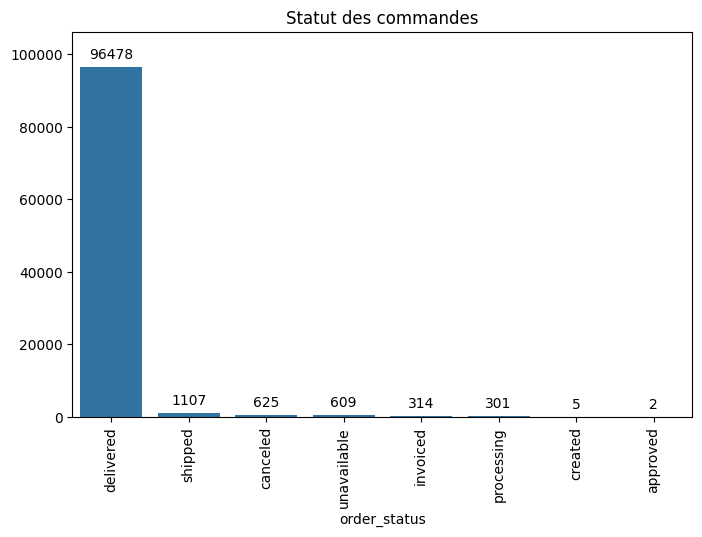

In [45]:
# Affichage des comptes des différents statuts de commande
statut_commandes_counts = commandes['order_status'].value_counts()
print(statut_commandes_counts)

# Représentation graphique du statut des commande
plt.figure(figsize=(8, 5))
ax = sns.barplot(x=statut_commandes_counts.index, y=statut_commandes_counts.values)
ax.bar_label(ax.containers[0], padding=4)
plt.title('Statut des commandes')
plt.xticks(rotation=90)
ax.margins(y=0.1)
plt.show()

* ### Filtrage des commandes livrées et Suppression de la colonne 'order_status' devenue inutile

Puisque nous allons garder uniquement les commandes livrées (delivered), la colonne order_status n'a plus d'intérêt car elle a une seule valeur répétée ("delivered").

Notre objectif principal est de segmenter les clients en fonction de leur comportement pour les campagnes marketing.

L’équipe Marketing s'intéresse donc aux clients ayant réellement acheté, pas aux commandes annulées ou en attente.

Les commandes annulées ou non traitées ne représentent pas un comportement d'achat actif, donc elles sont moins pertinentes pour la segmentation.

Cela va nous simplifier l’analyse en évitant le bruit des statuts non pertinents.

In [48]:
# Filtrage des commandes livrées
commandes = commandes[commandes['order_status'] == 'delivered']

# Suppression de la colonne 'order_status' devenue inutile
commandes.drop(columns=['order_status'], inplace=True)

# Affichage des premières lignes du DataFrame des commandes livrées
commandes.head()

,order_id,customer_id,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


* ### Conversion des dates en format datetime

In [50]:
# Liste des colonnes de type datetime
datetime_colonnes = [
    'order_purchase_timestamp', 'order_approved_at',
    'order_delivered_carrier_date', 'order_delivered_customer_date',
    'order_estimated_delivery_date'
]

# Conversion des colonnes de dates et heures en format datetime
for colonne in datetime_colonnes:
    commandes[colonne] = pd.to_datetime(commandes[colonne])

# Vérification : Affichage des premières lignes pour vérifier les conversions
print(commandes[datetime_colonnes].head())

  order_purchase_timestamp   order_approved_at order_delivered_carrier_date  \
0      2017-10-02 10:56:33 2017-10-02 11:07:15          2017-10-04 19:55:00   
1      2018-07-24 20:41:37 2018-07-26 03:24:27          2018-07-26 14:31:00   
2      2018-08-08 08:38:49 2018-08-08 08:55:23          2018-08-08 13:50:00   
3      2017-11-18 19:28:06 2017-11-18 19:45:59          2017-11-22 13:39:59   
4      2018-02-13 21:18:39 2018-02-13 22:20:29          2018-02-14 19:46:34   

  order_delivered_customer_date order_estimated_delivery_date  
0           2017-10-10 21:25:13                    2017-10-18  
1           2018-08-07 15:27:45                    2018-08-13  
2           2018-08-17 18:06:29                    2018-09-04  
3           2017-12-02 00:28:42                    2017-12-15  
4           2018-02-16 18:17:02                    2018-02-26  


In [51]:
print(commandes.dtypes)

order_id                                 object
customer_id                              object
order_purchase_timestamp         datetime64[ns]
order_approved_at                datetime64[ns]
order_delivered_carrier_date     datetime64[ns]
order_delivered_customer_date    datetime64[ns]
order_estimated_delivery_date    datetime64[ns]
dtype: object


* ### Vérification des valeurs manquantes

In [53]:
print(commandes.isnull().sum())

order_id                          0
customer_id                       0
order_purchase_timestamp          0
order_approved_at                14
order_delivered_carrier_date      2
order_delivered_customer_date     8
order_estimated_delivery_date     0
dtype: int64


**order_purchase_timestamp (0 valeurs manquantes):** Pas de problème ici, cette colonne est essentielle pour la segmentation basée sur la récence.

**order_approved_at (14 valeurs manquantes):** Cela signifie que certaines commandes n’ont pas été approuvées, ce qui est étrange si elles ont été livrées.
Ces commandes ont elles bien une date de livraison (order_delivered_customer_date)?
Si elles n'ont pas été approuvées mais livrées, on peut supposer que c'est une erreur d’enregistrement et les conserver. Sinon, on pourrait les exclure si elles sont incohérentes.

**order_delivered_customer_date (8 valeurs manquantes):** Cela signifie que certaines commandes livrées n’ont pas de date de livraison.
Ces commandes ont elles ont un order_delivered_carrier_date (date où le transporteur a pris en charge la commande)?
Nous pourrions les exclure si elles sont trop rares ou les garder en les considérant comme des livraisons en attente.

**order_delivered_carrier_date (2 valeurs manquantes):** Ces commandes n’ont même pas été prises en charge par un transporteur, ce qui signifie probablement un problème logistique.
Si elles ont quand même une order_delivered_customer_date, elles peuvent être gardées.
Sinon, nous pourrions les exclure si elles sont trop rares pour être significatives.

**order_estimated_delivery_date (0 valeurs manquantes):** Cette colonne est propre, et elle peut être utile pour analyser les retards de livraison.

* ### Gestion des valeurs manquantes
On traite les valeurs NaN pour éviter des problèmes dans les calculs.

In [56]:
# Remplacement des valeurs NaN de 'order_approved_at' par 'order_purchase_timestamp'
commandes['order_approved_at'] = commandes['order_approved_at'].fillna(commandes['order_purchase_timestamp'])

# Suppression des commandes sans date de livraison chez le client
commandes.dropna(subset=['order_delivered_customer_date', 'order_delivered_carrier_date'], inplace=True)

# Vérification du nombre de valeurs manquantes restantes
print(commandes.isnull().sum())

order_id                         0
customer_id                      0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
dtype: int64


* ### Création des délais de livraison
On calcule le délai total de livraison et le retard éventuel.

In [58]:
# Calcul du délai entre achat et livraison en jours
commandes['delai_livraison_jours'] = (commandes['order_delivered_customer_date'] - commandes['order_purchase_timestamp']).dt.days

# Calcul du retard de livraison (peut être négatif si livré en avance)
commandes['retard_livraison_jours'] = (commandes['order_delivered_customer_date'] - commandes['order_estimated_delivery_date']).dt.days
# forçons les valeurs négatives à 0 
commandes['retard_livraison_jours'] = commandes['retard_livraison_jours'].clip(lower=0)

# Vérification
print(commandes[['delai_livraison_jours', 'retard_livraison_jours']].describe())

       delai_livraison_jours  retard_livraison_jours
count           96469.000000            96469.000000
mean               12.093191                0.719257
std                 9.550565                4.652557
min                 0.000000                0.000000
25%                 6.000000                0.000000
50%                10.000000                0.000000
75%                15.000000                0.000000
max               209.000000              188.000000


**delai_livraison_jours**
* Moyenne : 12 jours
* Max : 209 jours : Très long, possiblement une anomalie
* Min : 0 jour (livraison le jour même)

**retard_livraison_jours**
* Moyenne : 0,71 jour (environ 17h de retard en moyenne)
* 75% des commandes n'ont pas de retard (0.00 en Q3)
* Max : 188 jours : Extrême, peut être une anomalie

Nous avons des délais très longs (209 jours) et des retards excessifs (188 jours).
Vérifions les valeurs extrêmes

Nous allons identifier les commandes problématiques

* **Commandes avec des délais de livraison anormalement longs (> 100 jours par exemple)**

In [61]:
# Affichage des commandes avec un délai anormalement long (> 100 jours)
commandes_livraison_longue = commandes[commandes['delai_livraison_jours'] > 100]
print(commandes_livraison_longue[['order_id', 'delai_livraison_jours']])

#Pourquoi 100 jours? 100 jours : Très long pour une livraison standard, probable erreur ou cas rare.

                               order_id  delai_livraison_jours
1621   a4efaffc506a395c9cea7402b078c1e5                    110
3077   8b7fd198ad184563c231653673e75a7f                    105
3202   4f39a94d6e474819d898d6df7d394996                    143
4666   b31c7dea63bb08f8cdd1ec32514ccf0b                    132
10383  3602a80b09d914236f74c733631f3b8b                    106
11399  47b40429ed8cce3aee9199792275433f                    191
12813  c2a550cc5f966506b717532441c221e5                    131
13672  d8dbb44d7c5b1fd8e7f41b49e27053d7                    104
16945  cce224811ba8fea016c049693c3e0402                    148
18731  7e708aed151d6a8601ce8f2eaa712bf4                    136
19590  ca07593549f1816d26a572e06dc1eab6                    209
20641  e52c9dfec957c503bed5d050a39c740f                    107
28331  b7624f6b70f7b79ea2b092b6f1be678c                    130
29265  6e6527028de694ccade37f5a15a6d84a                    165
29519  4fbc8d6f2f4db3e789d5a876fa349b56                

* **Commandes avec des délais de livraison anormalement longs (> 200 jours par exemple)**

In [63]:
commandes[commandes['delai_livraison_jours'] > 200]

,order_id,customer_id,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,delai_livraison_jours,retard_livraison_jours
19590,ca07593549f1816d26a572e06dc1eab6,75683a92331068e2d281b11a7866ba44,2017-02-21 23:31:27,2017-02-23 02:35:15,2017-03-08 13:47:46,2017-09-19 14:36:39,2017-03-22,209,181
55619,1b3190b2dfa9d789e1f14c05b647a14a,d306426abe5fca15e54b645e4462dc7b,2018-02-23 14:57:35,2018-02-23 15:16:14,2018-02-26 18:49:07,2018-09-19 23:24:07,2018-03-15,208,188


* **Commandes avec des retards de livraison extrêmes (> 2 mois de retard)**

In [65]:
# Affichage des commandes avec un retard excessif (> 60 jours)
commandes_retard_extreme = commandes[commandes['retard_livraison_jours'] > 60]
print(commandes_retard_extreme[['order_id', 'retard_livraison_jours']])

#Pourquoi 60 jours ? 60 jours de retard : 2 mois de retard est très inhabituel

                               order_id  retard_livraison_jours
1621   a4efaffc506a395c9cea7402b078c1e5                      73
3077   8b7fd198ad184563c231653673e75a7f                      91
3202   4f39a94d6e474819d898d6df7d394996                     112
4666   b31c7dea63bb08f8cdd1ec32514ccf0b                     109
4846   f390346ecbf61a6b81b92017a7410df1                      63
5335   c679466a1ba6a8bdedcb2396f9e1dcbd                      66
7740   00d1289d5125017a90e528b5a7cee91f                      74
11399  47b40429ed8cce3aee9199792275433f                     175
12813  c2a550cc5f966506b717532441c221e5                     104
13672  d8dbb44d7c5b1fd8e7f41b49e27053d7                      96
13815  77f1ce3b8d86fff49b9c811f00f4dc13                      70
16945  cce224811ba8fea016c049693c3e0402                     126
18731  7e708aed151d6a8601ce8f2eaa712bf4                      96
19590  ca07593549f1816d26a572e06dc1eab6                     181
20641  e52c9dfec957c503bed5d050a39c740f 

* **Commandes avec des retards de livraison extrêmes (> 6 mois de retard)**

In [67]:
commandes[commandes['retard_livraison_jours'] > 180]

,order_id,customer_id,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,delai_livraison_jours,retard_livraison_jours
19590,ca07593549f1816d26a572e06dc1eab6,75683a92331068e2d281b11a7866ba44,2017-02-21 23:31:27,2017-02-23 02:35:15,2017-03-08 13:47:46,2017-09-19 14:36:39,2017-03-22,209,181
55619,1b3190b2dfa9d789e1f14c05b647a14a,d306426abe5fca15e54b645e4462dc7b,2018-02-23 14:57:35,2018-02-23 15:16:14,2018-02-26 18:49:07,2018-09-19 23:24:07,2018-03-15,208,188


In [68]:
#suppression des commandes avec des délais de livraison et retards de livraison anormalement longs ? 
#Si oui, 100 et 60 ou 200 et 180?

## Suppression des commandes avec un délai de livraison excessif
#commandes = commandes[commandes['delai_livraison_jours'] <= 100]

# Suppression des commandes avec un retard excessif
#commandes = commandes[commandes['retard_livraison_jours'] <= 60]

### **VARIABLE RFM 1 : RECENCE (Recency)**
La récence mesure la date de la dernière interaction ou achat d’un client. En termes simples, cela répond à la question : "Quand ce client a-t-il effectué son dernier achat ?" Plus un client a acheté récemment, plus il est considéré comme engagé.

* ### Création du délai depuis le dernier achat
* Nous allons calculer l'ancienneté des commandes par rapport à une date de référence fictive en 2019.
* L'idée est de simuler une situation où nous sommes en 2019, alors que les commandes les plus récentes datent de 2018. Cela permet de :
    * Calculer combien de jours se sont écoulés depuis chaque commande
    * Analyser le comportement des clients (ex. fréquence d'achat, inactivité)
    *  Une valeur faible indiquera une récence élevée.

In [71]:
from datetime import datetime #datetime.now() appartient au module datetime.
from zoneinfo import ZoneInfo #ZoneInfo (pour gérer les fuseaux horaires) appartient au module zoneinfo.
from dateutil.relativedelta import relativedelta #relativedelta (pour soustraire des années) est dans dateutil.relativedelta.

# Date de référence fictive (dernière commande est en 2018, on simule "maintenant" en 2019)
date_reference = datetime.now(tz=ZoneInfo("America/Sao_Paulo")) - relativedelta(years=6)
date_reference = date_reference.replace(tzinfo=None)  # Supprimer la timezone


# Calcul du délai depuis le dernier achat
commandes['delai_dernier_achat_jours'] = (date_reference - commandes['order_purchase_timestamp']).dt.days

# Vérification des valeurs négatives
print(commandes[commandes['delai_dernier_achat_jours'] < 0][['order_purchase_timestamp', 'delai_dernier_achat_jours']])


Empty DataFrame
Columns: [order_purchase_timestamp, delai_dernier_achat_jours]
Index: []


Le fait d'obtenir un DataFrame vide signifie que toutes les valeurs calculées sont positives ou nulles. Autrement dit :
* Il n'y a pas de commandes du futur dans nos données.
* Notre calcul de l'ancienneté des commandes fonctionne correctement.
* Toutes les dates d'achat sont bien antérieures à la date de référence simulée (2019).

In [73]:
print(commandes[['order_purchase_timestamp', 'delai_dernier_achat_jours']].head(10))

   order_purchase_timestamp  delai_dernier_achat_jours
0       2017-10-02 10:56:33                        511
1       2018-07-24 20:41:37                        215
2       2018-08-08 08:38:49                        201
3       2017-11-18 19:28:06                        464
4       2018-02-13 21:18:39                        376
5       2017-07-09 21:57:05                        595
7       2017-05-16 13:10:30                        650
8       2017-01-23 18:29:09                        763
9       2017-07-29 11:55:02                        576
10      2017-05-16 19:41:10                        650


**Nos résultats semblent cohérents avec une date de référence en 2019 :**
* Une commande du 02/10/2017 a une ancienneté de 496 jours
* Une commande du 24/07/2018 a une ancienneté de 200 jours
* Une commande du 08/08/2018 a une ancienneté de 186 jours

**Tout correspond bien à la logique des dates.**

* vérifions que la date de référence est bien fixée en 2019.

In [76]:
print(date_reference)

2019-02-25 19:47:49.303248


* ### Extraction d’informations temporelles
Nous allons extraire des caractéristiques temporelles de chaque commande (heure, mois, jour de la commande), pour analyser les comportements des clients et faire de la segmentation.

In [78]:
# Extraction de l'heure et du mois de commande
commandes['heure_commande'] = commandes['order_purchase_timestamp'].dt.hour
commandes['mois_commande'] = commandes['order_purchase_timestamp'].dt.month

# Jour de la semaine (Lundi = 1, Dimanche = 7)
commandes['jour_commande'] = commandes['order_purchase_timestamp'].dt.weekday + 1

# Vérification
print(commandes[['heure_commande', 'mois_commande', 'jour_commande']].head())

   heure_commande  mois_commande  jour_commande
0              10             10              1
1              20              7              2
2               8              8              3
3              19             11              6
4              21              2              2


**Détails des extractions :**
* **Heure de commande (heure_commande) :** Permet d’analyser les moments les plus populaires de la journée pour les achats. **Par exemple** si beaucoup de commandes sont passées entre 20h et 22h, cela peut indiquer une forte activité en soirée.

* **Mois de commande (mois_commande) :** Permet de repérer des saisonnalités dans les achats. **Par exemple** une hausse des commandes en novembre-décembre peut être liée aux achats de fêtes de fin d’année.

* **Jour de la semaine (jour_commande) :** Permet d’analyser les jours les plus actifs. **Par exemple** si beaucoup de commandes sont passées le lundi et le vendredi, on peut adapter le marketing en conséquence.

**Pourquoi cela est utile ?**
* Planifier des promotions aux moments où les clients achètent le plus.
* Gérer les stocks en fonction des jours les plus demandés, en prévoyant les pics de commandes.
* Personnaliser les offres selon les habitudes des clients.
* Adapter les horaires des campagnes marketing ou des publicités.
***

* ### Visualisation des commandes dans le temps
Nous allons analyser comment les commandes sont réparties dans le temps.

Début des commandes : 2016-09-15 12:16:38, Fin des commandes : 2018-08-29 15:00:37


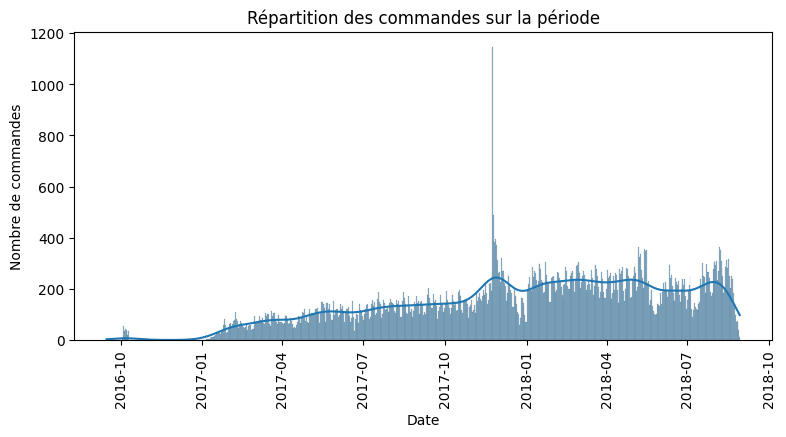

In [81]:
import matplotlib.pyplot as plt
import seaborn as sns

# Extraction de la date sans l'heure. 
#Cela permet d'avoir uniquement la date de la commande (sans l'heure), pour observer les tendances quotidiennes.
commandes['order_date'] = commandes['order_purchase_timestamp'].dt.date

# Affichage de la période des commandes
# On cherche la première et la dernière commande enregistrées dans le dataset. Cela donne une idée de l'intervalle temporel couvert par les données.
date_debut = commandes['order_purchase_timestamp'].min()
date_fin = commandes['order_purchase_timestamp'].max()
print(f"Début des commandes : {date_debut}, Fin des commandes : {date_fin}")

# Histogramme des commandes par date avec KDE
plt.figure(figsize=(9, 4))
sns.histplot(commandes['order_date'].sort_values(), bins=50, kde=True)  # Ajout de kde=True
plt.xticks(rotation=90)
plt.title('Répartition des commandes sur la période')
plt.xlabel('Date')
plt.ylabel('Nombre de commandes')
plt.show()

**Cela sert à :**
* Détecter les tendances (Repérer des périodes de forte ou faible activité).
* Prévoir les stocks (Anticiper les périodes où la demande est plus forte).
* Optimiser le marketing (Planifier des promotions ou campagnes publicitaires aux bons moments).

**Ici, l’histogramme montre un pic en novembre/décembre, cela pourrait indiquer une augmentation des achats pour les fêtes, ou suggérant des campagnes spécifiques qui ont stimulé les ventes.**

**La période des commandes s’étend de septembre 2016 à août 2018.**

**En fin d'année 2016, le nombre de commandes est très faible, ce qui pourrait indiquer un démarrage ou une période de faible activité.**

**Le nombre de commandes commence à augmenter de manière régulière à partir de janvier 2017.**

* ### Suppression des colonnes inutiles
On supprime les colonnes dont on n’a plus besoin.

In [84]:
# Liste des colonnes à supprimer
colonnes_a_supprimer = [
    'order_purchase_timestamp',
    'order_approved_at',
    'order_delivered_carrier_date',
    'order_delivered_customer_date',
    'order_estimated_delivery_date'
]

# Suppression des colonnes
commandes.drop(columns=colonnes_a_supprimer, inplace=True)

# Vérification des colonnes restantes
print(commandes.head())

                           order_id                       customer_id  \
0  e481f51cbdc54678b7cc49136f2d6af7  9ef432eb6251297304e76186b10a928d   
1  53cdb2fc8bc7dce0b6741e2150273451  b0830fb4747a6c6d20dea0b8c802d7ef   
2  47770eb9100c2d0c44946d9cf07ec65d  41ce2a54c0b03bf3443c3d931a367089   
3  949d5b44dbf5de918fe9c16f97b45f8a  f88197465ea7920adcdbec7375364d82   
4  ad21c59c0840e6cb83a9ceb5573f8159  8ab97904e6daea8866dbdbc4fb7aad2c   

   delai_livraison_jours  retard_livraison_jours  delai_dernier_achat_jours  \
0                      8                       0                        511   
1                     13                       0                        215   
2                      9                       0                        201   
3                     13                       0                        464   
4                      2                       0                        376   

   heure_commande  mois_commande  jour_commande  order_date  
0              10       

# ____________________________________________________________

# 2.2. Table "olist_order_items_dataset" (Articles de commande) <a id="Table-olist_order_items_dataset-(Articles de commande)"></a>

* ### Chargement des données

In [88]:
# Chargement des données des articles achetés
articles = pd.read_csv('olist_order_items_dataset.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [90]:
articles.shape

(112650, 7)

Ce jeu de données contient 112650 lignes (articles commandés) et 7 colonnes, avec des informations sur les articles commandés, les prix, les frais de port, les dates, etc.

* ### Résumé des variables qualitatives

In [93]:
articles.describe(exclude=[np.number])

,order_id,product_id,seller_id,shipping_limit_date
count,112650,112650,112650,112650
unique,98666,32951,3095,93318
top,8272b63d03f5f79c56e9e4120aec44ef,aca2eb7d00ea1a7b8ebd4e68314663af,6560211a19b47992c3666cc44a7e94c0,2017-07-21 18:25:23
freq,21,527,2033,21


* ### Résumé des variables quantitatives

In [95]:
articles.describe()

,order_item_id,price,freight_value
count,112650.000000,112650.000000,112650.000000
mean,1.197834,120.653739,19.990320
std,0.705124,183.633928,15.806405
min,1.000000,0.850000,0.000000
25%,1.000000,39.900000,13.080000
50%,1.000000,74.990000,16.260000
75%,1.000000,134.900000,21.150000
max,21.000000,6735.000000,409.680000


L'exploration des colonnes avec des données numériques (prix, frais de port) permet de constater des informations intéressantes, comme les écarts importants entre le prix minimum (0,85 BRL) et maximum (6735 BRL), ce qui pourrait indiquer des produits très différents en termes de prix. :

**Prix des articles :**
* Prix moyen : environ 120.65 BRL
* Prix max : 6735 BRL : Produit très cher
* Prix min : 0.85 BRL : Prix anormalement bas ?

**Frais de livraison (freight_value) :**
* Moyenne : 19.99 BRL
* Max : 409.68 BRL : Peut être un produit très volumineux ?
* Min : 0.00 BRL : Certains articles ont la livraison gratuite.

* ### Types de données

In [98]:
articles.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


Notre DataFrame contient :
* 2 colonnes de type float64.
* 1 colonne de type int64.
* 4 colonnes de type object.

memory usage: 6.0+ MB : Cela indique que le DataFrame utilise environ 6,0 Mégaooctets (MB) de mémoire.

* ### Aperçu rapide des premières lignes du jeu de données

In [101]:
# Affichage des premières lignes du DataFrame des articles
articles.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


* ### Nombre de valeurs uniques 

In [103]:
# Nombre de valeurs différentes par colonne
articles.nunique()

order_id               98666
order_item_id             21
product_id             32951
seller_id               3095
shipping_limit_date    93318
price                   5968
freight_value           6999
dtype: int64

- Le nombre de commandes uniques dans ce DataFrame est de 98666, et donc une seule ligne par numéro de commande; Certaines commandes contiennent plusieurs articles.
- Le nombre de produits uniques dans ce DataFrame est de 32951 (produits différents).
- Le nombre de vendeurs uniques dans ce DataFrame est de 3095; Beaucoup de vendeurs, ce qui montre une marketplace diversifiée.

* ### Identification des doublons 

In [106]:
# Vérification du nombre de doublons
nombre_doublons = articles.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 0


* ### Vérification des valeurs manquantes 

In [108]:
print(articles.isnull().sum())

order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64


Il n'y a aucune valeur manquante dans ce dataframe.

* ### Calcul du total des ventes et des frais de port
Pour avoir une idée globale des revenus et des frais liés aux ventes.

In [111]:
# Calcul du total des ventes et des frais de port
total_price = articles['price'].sum().round(2)
total_freight = articles['freight_value'].sum().round(2)

print(f" Montant total des articles vendus : {total_price} BRL")
print(f" Montant total des frais de port : {total_freight} BRL")

 Montant total des articles vendus : 13591643.7 BRL
 Montant total des frais de port : 2251909.54 BRL


* ### Top 10 des vendeurs avec le plus d'articles vendus
Permet d'identifier les vendeurs qui dominent le marché.

In [113]:
# Top 10 des vendeurs avec le plus d'articles vendus
top_vendeurs = articles['seller_id'].value_counts().head(10)
print("\n Top 10 des vendeurs avec le plus d'articles vendus :")
print(top_vendeurs)


 Top 10 des vendeurs avec le plus d'articles vendus :
seller_id
6560211a19b47992c3666cc44a7e94c0    2033
4a3ca9315b744ce9f8e9374361493884    1987
1f50f920176fa81dab994f9023523100    1931
cc419e0650a3c5ba77189a1882b7556a    1775
da8622b14eb17ae2831f4ac5b9dab84a    1551
955fee9216a65b617aa5c0531780ce60    1499
1025f0e2d44d7041d6cf58b6550e0bfa    1428
7c67e1448b00f6e969d365cea6b010ab    1364
ea8482cd71df3c1969d7b9473ff13abc    1203
7a67c85e85bb2ce8582c35f2203ad736    1171
Name: count, dtype: int64


* ### Top 10 des articles les plus vendus
Certains articles sont-ils ultra populaires ? Cela pourrait aider à détecter des tendances de consommation et à mieux comprendre les produits populaires.

In [115]:
top_products = articles['product_id'].value_counts().head(10)
print("\n Top 10 des articles les plus vendus :")
print(top_products)


 Top 10 des articles les plus vendus :
product_id
aca2eb7d00ea1a7b8ebd4e68314663af    527
99a4788cb24856965c36a24e339b6058    488
422879e10f46682990de24d770e7f83d    484
389d119b48cf3043d311335e499d9c6b    392
368c6c730842d78016ad823897a372db    388
53759a2ecddad2bb87a079a1f1519f73    373
d1c427060a0f73f6b889a5c7c61f2ac4    343
53b36df67ebb7c41585e8d54d6772e08    323
154e7e31ebfa092203795c972e5804a6    281
3dd2a17168ec895c781a9191c1e95ad7    274
Name: count, dtype: int64


* ### Distribution des prix des articles

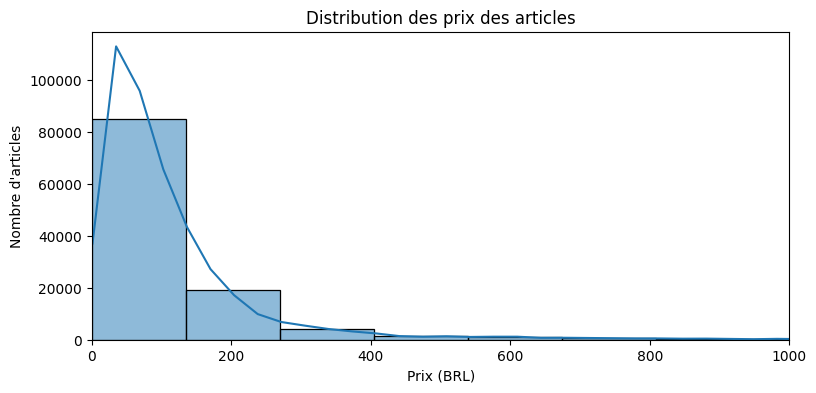

In [117]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(9, 4))
sns.histplot(articles['price'], bins=50, kde=True)
plt.xlim(0, 1000)  # On limite l'affichage aux produits ≤ 1000 BRL pour éviter les outliers
plt.title("Distribution des prix des articles")
plt.xlabel("Prix (BRL)")
plt.ylabel("Nombre d'articles")
plt.show()

On voit une asymétrie à droite, ce qui signifie que la majorité des articles ont un prix bas (moins de 200 BRL).
Il y a une longue traîne vers des prix élevés, mais il n'y en a pas beaucoup.

La présence de produits très chers (outliers) pourrait suggérer qu’il faut peut-être ajuster l’analyse pour se concentrer sur les prix plus représentatifs de la majorité des ventes?

* ### Corrélation entre prix et frais de port
On veut voir si les frais de port augmentent avec le prix du produit.

In [120]:
correlation = articles[['price', 'freight_value']].corr().iloc[0, 1]
print(f" Coefficient de corrélation entre prix et frais de port : {correlation:.2f}")

 Coefficient de corrélation entre prix et frais de port : 0.41


Il n’y a pas de relation linéaire évidente entre prix et frais de port, bien que certains articles plus chers puissent avoir des frais plus élevés.

# ____________________________________________________________

# 2.3. Table "olist_products_dataset" (Informations sur les Produits) <a id="Table-olist_products_dataset-(Informations-sur-les-Produits)"></a>

* ### Chargement des données

In [125]:
# Chargement des données des informations sur les produits
products = pd.read_csv('olist_products_dataset.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [127]:
products.shape

(32951, 9)

Ce jeu de données contient 32951 lignes et 9 colonnes.

* ### Résumé des variables qualitatives

In [130]:
products.describe(exclude=[np.number])

,product_id,product_category_name
count,32951,32341
unique,32951,73
top,1e9e8ef04dbcff4541ed26657ea517e5,cama_mesa_banho
freq,1,3029


* ### Résumé des variables quantitatives

In [132]:
products.describe()

,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,32341.000000,32341.000000,32341.000000,32949.000000,32949.000000,32949.000000,32949.000000
mean,48.476949,771.495285,2.188986,2276.472488,30.815078,16.937661,23.196728
std,10.245741,635.115225,1.736766,4282.038731,16.914458,13.637554,12.079047
min,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000
25%,42.000000,339.000000,1.000000,300.000000,18.000000,8.000000,15.000000
50%,51.000000,595.000000,1.000000,700.000000,25.000000,13.000000,20.000000
75%,57.000000,972.000000,3.000000,1900.000000,38.000000,21.000000,30.000000
max,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000


* ### Types de données

In [134]:
products.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


Notre DataFrame contient :
* 7 colonnes de type float
* 2colonnes de type object.

memory usage: 2.3+ MB : Cela indique que le DataFrame utilise environ 2,3 Mégaooctets (MB) de mémoire.

* ### Aperçu rapide des premières lignes du jeu de données

In [137]:
# Affichage des premières lignes du DataFrame des commandes
products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


* ### Nombre de valeurs uniques 

In [139]:
# Nombre de valeurs différentes par colonne
products.nunique()

product_id                    32951
product_category_name            73
product_name_lenght              66
product_description_lenght     2960
product_photos_qty               19
product_weight_g               2204
product_length_cm                99
product_height_cm               102
product_width_cm                 95
dtype: int64

**product_id (32951 valeurs uniques) :** Chaque produit a un identifiant unique dans ce DataFrame soit au total 32951, ce qui est logique puisque chaque ligne de la table représente un produit distinct.

**product_category_name (73 catégories uniques) :** Il y a 73 catégories différentes pour les produits, ce qui montre une grande diversité de types de produits dans cette base de données. C’est assez standard pour une plateforme de e-commerce. 

**product_name_lenght (66 longueurs uniques) :** La longueur des noms des produits varie sur 66 valeurs différentes. Cela suggère que la plupart des noms sont assez similaires en longueur, mais il existe des écarts (certaines peuvent être plus longues ou plus courtes).

**product_description_lenght (2960 longueurs uniques) :** Les descriptions des produits ont une grande diversité de longueurs. Cela est logique puisque certaines descriptions de produits peuvent être très détaillées, tandis que d'autres peuvent être plus courtes.

**product_photos_qty (19 valeurs uniques) :** Le nombre de photos des produits varie entre 1 et 20, avec un total de 19 valeurs uniques. Cela montre que la plupart des produits ont un nombre de photos relativement faible, mais certaines ont beaucoup plus de photos. 

**product_weight_g (2204 valeurs uniques) :** Le poids des produits varie considérablement avec 2204 valeurs uniques. Cela montre qu'il existe une large gamme de poids, des produits très légers (presque zéro) aux produits extrêmement lourds, comme des meubles ou des appareils électroménagers.

**product_length_cm (99 valeurs uniques) :** La longueur des produits varie sur 99 valeurs différentes, ce quidonne une bonne idée de la diversité des tailles des produits.

**product_height_cm (102 valeurs uniques) :** Le même raisonnement s'applique à la hauteur des produits, avec une gamme d'environ 102 tailles différentes, ce qui montre que la table couvre bien une grande variété de produits.

**product_width_cm (95 valeurs uniques) :** Enfin, la largeur des produits présente 95 valeurs uniques, encore une fois un large éventail, ce qui est cohérent avec la diversité des tailles de produits.


* ### Identification des doublons 

In [142]:
# Vérification du nombre de doublons
nombre_doublons = products.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 0


* ### Vérification des valeurs manquantes 

In [144]:
print(products.isnull().sum())

product_id                      0
product_category_name         610
product_name_lenght           610
product_description_lenght    610
product_photos_qty            610
product_weight_g                2
product_length_cm               2
product_height_cm               2
product_width_cm                2
dtype: int64


* ### Gestion des valeurs manquantes 

Même s'il n'y a pas beaucoup de NaN, on peut les gérer :

* 610 valeurs manquantes dans **product_category_name** : remplaçons NaN par "unknown"
* 610 valeurs manquantes dans **product_name_length, product_description_length, product_photos_qty** : remplaçons par la médiane
* 2 valeurs manquantes dans **product_weight_g**, Remplacement des poids égaux à 0g, par NaN, puis remplacement par la moyenne des produits similaires (KNN)
* 2 valeurs manquantes dans **product_length_cm**, remplacement par la moyenne des produits similaires (KNN)
* 2 valeurs manquantes dans **product_height_cm**, remplacement par la moyenne des produits similaires (KNN)
* 2 valeurs manquantes dans **product_width_cm**, remplacement par la moyenne des produits similaires (KNN)

#### **Traitement des valeurs manquantes dans "product_category_name"**
Remplacement des NaN dans 'product_category_name' par "unknown" pour ne pas perdre ces produits

In [148]:
# Nombre de produits sans nom de catégorie
produits_sans_product_category_name = products['product_category_name'].isna().sum()
print(f"Il y a {produits_sans_product_category_name} produits qui n'ont pas de nom de catégorie.")

Il y a 610 produits qui n'ont pas de nom de catégorie.


In [149]:
# Remplacement des NaN dans 'product_category_name' par "unknown" 
products['product_category_name']= products['product_category_name'].fillna('unknown')

#### **Traitement des valeurs manquantes dans "product_name_length", "product_description_length" et "product_photos_qty"**
Imputation des valeurs manquantes pour les colonnes numériques
On remplit avec la médiane pour éviter les biais des valeurs extrêmes :

In [151]:
# Longueur du nom du produit
nom_min = int(products['product_name_lenght'].min())
nom_max = int(products['product_name_lenght'].max())
print(f"Les produits ont un nom allant de {nom_min} à {nom_max} lettres.")

# Longueur de la description du produit
description_min = int(products['product_description_lenght'].min())
description_max = int(products['product_description_lenght'].max())
print(f"Les produits ont une description allant de {description_min} à {description_max} lettres.")

# Nombre de photos du produit
photos_min = int(products['product_photos_qty'].min())
photos_max = int(products['product_photos_qty'].max())
print(f"Les produits ont un nombre de photos allant de {photos_min} à {photos_max}.")

Les produits ont un nom allant de 5 à 76 lettres.
Les produits ont une description allant de 4 à 3992 lettres.
Les produits ont un nombre de photos allant de 1 à 20.


In [152]:
# Remplacement des NaN dans les colonnes numériques par la médiane
colonnes_a_remplir = ['product_name_lenght', 'product_description_lenght', 'product_photos_qty']
for col in colonnes_a_remplir:
    products[col] = products[col].fillna(products[col].median())

#### **Traitement des valeurs manquantes dans "product_weight_g", "product_length_cm", "product_height_cm" et "product_width_cm"**
Imputation des valeurs manquantes avec KNN (proche voisin)

In [154]:
# Poids des produits
poids_min = int(products['product_weight_g'].min())
poids_max = int(products['product_weight_g'].max())
print(f"Les produits ont un poids allant de {poids_min} à {poids_max} grammes.")

# Filtrer et afficher les produits dont le poids est égal à zéro
produits_poids_zero = products[products['product_weight_g'] == 0]
print(f"Il y a {len(produits_poids_zero)} produits dont le poids est égal à zéro.")

produits_poids_zero

Les produits ont un poids allant de 0 à 40425 grammes.
Il y a 4 produits dont le poids est égal à zéro.


,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
9769,81781c0fed9fe1ad6e8c81fca1e1cb08,cama_mesa_banho,51.0,529.0,1.0,0.0,30.0,25.0,30.0
13683,8038040ee2a71048d4bdbbdc985b69ab,cama_mesa_banho,48.0,528.0,1.0,0.0,30.0,25.0,30.0
14997,36ba42dd187055e1fbe943b2d11430ca,cama_mesa_banho,53.0,528.0,1.0,0.0,30.0,25.0,30.0
32079,e673e90efa65a5409ff4196c038bb5af,cama_mesa_banho,53.0,528.0,1.0,0.0,30.0,25.0,30.0


In [155]:
# Remplacement des poids égaux à 0g, par NaN pour les imputer ensuite
products['product_weight_g'] = products['product_weight_g'].replace(0, np.nan)

# Création de l'imputer KNN
# On veut les remplacer intelligemment (par la moyenne des produits similaires) :
from sklearn.impute import KNNImputer
colonnes_a_imputer = ['product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm']
imputer = KNNImputer(n_neighbors=2)

# Application de l'imputer aux colonnes sélectionnées
products[colonnes_a_imputer] = imputer.fit_transform(products[colonnes_a_imputer])

#### **Création d’une nouvelle colonne volume_du_produit**

In [157]:
# Pour avoir une idée du volume du produit
products['product_volume_cm3'] = (
    products['product_length_cm'] * 
    products['product_height_cm'] * 
    products['product_width_cm']
)

#### **Suppression des colonnes inutilisées**

In [159]:
# Puis, on peut supprimer les colonnes individuelles si on n’en a plus besoin :
products.drop(columns=['product_length_cm', 'product_height_cm', 'product_width_cm'], inplace=True)

* ### Top 10 des catégories les plus fréquentes
Pour avoir un aperçu des catégories qui reviennent le plus souvent.

In [161]:
top_categories = products['product_category_name'].value_counts().head(10)
print("\nTop 10 des catégories de produits les plus fréquentes :")
print(top_categories)


Top 10 des catégories de produits les plus fréquentes :
product_category_name
cama_mesa_banho           3029
esporte_lazer             2867
moveis_decoracao          2657
beleza_saude              2444
utilidades_domesticas     2335
automotivo                1900
informatica_acessorios    1639
brinquedos                1411
relogios_presentes        1329
telefonia                 1134
Name: count, dtype: int64


Nous avons trouvé que les 10 premières catégories sont dominées par des produits comme ceux de la literie (cama_mesa_banho), du sport et loisirs (esporte_lazer), et de la décoration (moveis_decoracao).

* ### Visualisation
On pourra mieux visualiser quelles sont les catégories dominantes.

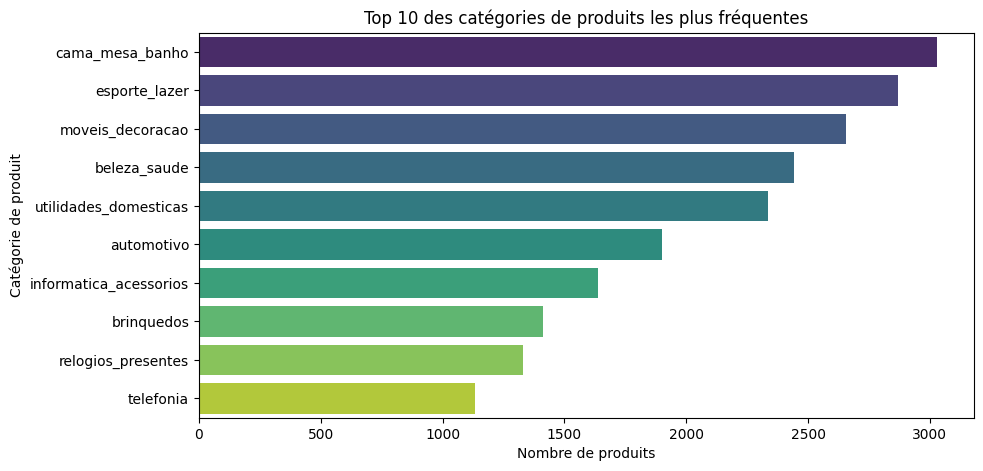

In [164]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 5))
sns.barplot(x=top_categories.values, y=top_categories.index, hue=top_categories.index, palette="viridis", legend=False)
plt.xlabel("Nombre de produits")
plt.ylabel("Catégorie de produit")
plt.title("Top 10 des catégories de produits les plus fréquentes")
plt.show()

* ### Analyse des volumes et poids moyens par catégorie
Pour voir quelles catégories ont des articles plus lourds et volumineux, ce qui peut influencer les frais de livraison.

In [166]:
# Regroupement par catégorie et calcul des moyennes
stats_categories = products.groupby('product_category_name')[['product_weight_g', 'product_volume_cm3']].mean().sort_values(by='product_weight_g', ascending=False)

# Affichage des 10 catégories avec les produits les plus lourds
print("\nTop 10 des catégories avec les produits les plus lourds :")
print(stats_categories.head(10))


Top 10 des catégories avec les produits les plus lourds :
                                                product_weight_g  \
product_category_name                                              
moveis_colchao_e_estofado                           13190.000000   
moveis_escritorio                                   12740.867314   
moveis_cozinha_area_de_servico_jantar_e_jardim      11598.563830   
moveis_quarto                                        9997.222222   
eletrodomesticos_2                                   9913.333333   
moveis_sala                                          8934.846154   
pcs                                                  7995.333333   
industria_comercio_e_negocios                        5929.191176   
agro_industria_e_comercio                            5263.405405   
climatizacao                                         4459.959677   

                                                product_volume_cm3  
product_category_name                                  

Cela permet d’avoir une vision plus précise des types de produits qui prennent plus de place et sont plus coûteux à expédier.

# 2.4. Table "products_category_name_translation" (Traduction en anglais des noms de catégories de produits) <a id="Table-products_category_name_translation-(Traduction-en-anglais-des-noms-de-catégories-de-produits)"></a>

* ### Chargement des données

In [170]:
# Chargement des données de traduction des catégories
traduction = pd.read_csv('product_category_name_translation.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [172]:
traduction.shape

(71, 2)

Ce jeu de données contient 71 lignes et 2 colonnes.

* ### Résumé des variables qualitatives

In [175]:
traduction.describe(exclude=[np.number])

,product_category_name,product_category_name_english
count,71,71
unique,71,71
top,beleza_saude,health_beauty
freq,1,1


* ### Résumé des variables quantitatives

In [177]:
traduction.describe()

,product_category_name,product_category_name_english
count,71,71
unique,71,71
top,beleza_saude,health_beauty
freq,1,1


* ### Types de données   

In [179]:
traduction.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


Notre DataFrame contient :
* 2 colonnes de type object.

memory usage: 1.2+ MB ?: Cela indique que le DataFrame utilise environ 1,2 Mégaooctets (MB) ?de mémoire.

* ### Aperçu rapide des premières lignes du jeu de données

In [182]:
# Affichage des premières lignes du DataFrame
traduction.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


* ### Nombre de valeurs uniques

In [184]:
# Nombre de valeurs différentes par colonne
traduction.nunique()

product_category_name            71
product_category_name_english    71
dtype: int64

Nous observons que chaque nom de catégorie de produit en portugais a une traduction unique en anglais, ce qui confirme qu'il n'y a pas de duplications dans les noms des catégories.

* ### Identification des doublons

In [187]:
# Vérification du nombre de doublons
nombre_doublons = traduction.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 0


* ### Vérification des valeurs manquantes

In [189]:
print(traduction.isnull().sum())

product_category_name            0
product_category_name_english    0
dtype: int64


* ### Fusion avec la table "olist_products_dataset"
Pour obtenir des noms de catégories en anglais et faciliter l'analyse.

On garde toutes les catégories existantes et on ajoute leurs traductions.

In [191]:
# Fusion de la table de produits avec la traduction des catégories
products = products.merge(traduction, on="product_category_name", how="left")

# Vérification que la fusion s'est bien passée
products[['product_category_name', 'product_category_name_english']].head(10)

,product_category_name,product_category_name_english
0,perfumaria,perfumery
1,artes,art
2,esporte_lazer,sports_leisure
3,bebes,baby
4,utilidades_domesticas,housewares
5,instrumentos_musicais,musical_instruments
6,cool_stuff,cool_stuff
7,moveis_decoracao,furniture_decor
8,eletrodomesticos,home_appliances
9,brinquedos,toys


Nous avons fusionné la table products avec celle des traductions (product_category_name_translation) en utilisant la colonne product_category_name. Cela a ajouté la colonne product_category_name_english à la table products.

Maintenant, chaque produit dispose à la fois du nom de la catégorie en portugais et en anglais.

In [193]:
products

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_volume_cm3,product_category_name_english
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,2240.0,perfumery
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,10800.0,art
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,2430.0,sports_leisure
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,2704.0,baby
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,4420.0,housewares
...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,45.0,67.0,2.0,12300.0,64000.0,furniture_decor
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,41.0,971.0,1.0,1700.0,4864.0,construction_tools_lights
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,50.0,799.0,1.0,1400.0,5103.0,bed_bath_table
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,60.0,156.0,2.0,700.0,8060.0,computers_accessories


In [194]:
# Repositionnement de la colonne 'product_category_name_english' à la 2ème position
# Création d'une liste des colonnes
cols = products.columns.tolist()

# Retrait de 'product_category_name_english' de sa position actuelle
cols.remove('product_category_name_english')

# Insertion de 'product_category_name_english' à la 2ème position (l'index commence à 0, donc 2 correspond à la 2ème position)
cols.insert(2, 'product_category_name_english')

# Réorganisation du DataFrame avec le nouvel ordre de colonnes
products = products[cols]

products

,product_id,product_category_name,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_volume_cm3
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,perfumery,40.0,287.0,1.0,225.0,2240.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,art,44.0,276.0,1.0,1000.0,10800.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,sports_leisure,46.0,250.0,1.0,154.0,2430.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,baby,27.0,261.0,1.0,371.0,2704.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,housewares,37.0,402.0,4.0,625.0,4420.0
...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,furniture_decor,45.0,67.0,2.0,12300.0,64000.0
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,construction_tools_lights,41.0,971.0,1.0,1700.0,4864.0
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,bed_bath_table,50.0,799.0,1.0,1400.0,5103.0
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,computers_accessories,60.0,156.0,2.0,700.0,8060.0


# ____________________________________________________________

# 2.5. Table "olist_customers_dataset" (Clients) <a id="Table-olist_customers_dataset-(Clients)"></a>

* ### Chargement des données

In [198]:
# Chargement des données des clients
clients = pd.read_csv('olist_customers_dataset.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [200]:
clients.shape

(99441, 5)

Ce jeu de données contient 99441 lignes et 5 colonnes.

* ### Résumé des variables qualitatives

In [203]:
clients.describe(exclude=[np.number])

,customer_id,customer_unique_id,customer_city,customer_state
count,99441,99441,99441,99441
unique,99441,96096,4119,27
top,06b8999e2fba1a1fbc88172c00ba8bc7,8d50f5eadf50201ccdcedfb9e2ac8455,sao paulo,SP
freq,1,17,15540,41746


* 99 441 clients au total.
* 96 096 clients uniques (customer_unique_id), donc certains clients ont passé plusieurs commandes.
* 4 119 villes représentées, la plus fréquente étant São Paulo avec 15 540 clients.
* 27 États brésiliens (customer_state), avec SP (São Paulo) en tête (41 746 clients).

* ### Résumé des variables quantitatives

In [206]:
clients.describe()

,customer_zip_code_prefix
count,99441.000000
mean,35137.474583
std,29797.938996
min,1003.000000
25%,11347.000000
50%,24416.000000
75%,58900.000000
max,99990.000000


* ### Types de données

In [208]:
clients.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


Notre DataFrame contient :
* 1 colonne de type int64
* 4 colonnes de type object.

memory usage: 3.8+ MB : Cela indique que le DataFrame utilise environ 3,8 Mégaooctets (MB) de mémoire.

* ### Aperçu rapide des premières lignes du jeu de données

In [211]:
# Affichage des premières lignes du DataFrame des clients
clients.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


* ### Nombre de valeurs uniques 

In [213]:
# Nombre de valeurs différentes par colonne
clients.nunique()

customer_id                 99441
customer_unique_id          96096
customer_zip_code_prefix    14994
customer_city                4119
customer_state                 27
dtype: int64

Le nombre total de clients correspond exactement au nombre de commande, soit 99441, et donc une seule ligne par client et par numéro de commande. 

* ### Identification des doublons 

In [216]:
# Vérification du nombre de doublons
nombre_doublons = clients.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 0


* ### Vérification des valeurs manquantes 

In [218]:
print(clients.isnull().sum())

customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64


* ### Nombre de clients par État
Avant de visualiser, on affiche les chiffres

In [220]:
# Compter le nombre de clients par état
clients_par_etat = clients['customer_state'].value_counts()

# Afficher les résultats
print(clients_par_etat)

customer_state
SP    41746
RJ    12852
MG    11635
RS     5466
PR     5045
SC     3637
BA     3380
DF     2140
ES     2033
GO     2020
PE     1652
CE     1336
PA      975
MT      907
MA      747
MS      715
PB      536
PI      495
RN      485
AL      413
SE      350
TO      280
RO      253
AM      148
AC       81
AP       68
RR       46
Name: count, dtype: int64


Le nombre de clients par état montre que São Paulo et Rio de Janeiro sont les deux États les plus représentés.

* ### Conversion des codes postaux et transformation des États
On s’assure que le code postal est une chaîne de caractères et on applique la Transformation des abréviations des états en leurs noms complets à l'aide d'un dictionnaire de correspondance.

In [223]:
# Conversion des codes postaux en chaîne de caractères
clients['customer_zip_code_prefix'] = clients['customer_zip_code_prefix'].astype(str)



# Transformation des noms d'États en noms complets
# Dictionnaire de correspondance des abréviations d'États brésiliens vers leurs noms complets
carte_id_etat = {
    "AC": "Acre",
    "AL": "Alagoas",
    "AP": "Amapá",
    "AM": "Amazonas",
    "BA": "Bahia",
    "CE": "Ceará",
    "DF": "Distrito Federal",
    "ES": "Espírito Santo",
    "GO": "Goiás",
    "MA": "Maranhão",
    "MT": "Mato Grosso",
    "MS": "Mato Grosso do Sul",
    "MG": "Minas Gerais",
    "PA": "Pará",
    "PB": "Paraíba",
    "PR": "Paraná",
    "PE": "Pernambuco",
    "PI": "Piauí",
    "RJ": "Rio de Janeiro",
    "RN": "Rio Grande do Norte",
    "RS": "Rio Grande do Sul",
    "RO": "Rondônia",
    "RR": "Roraima",
    "SC": "Santa Catarina",
    "SP": "São Paulo",
    "SE": "Sergipe",
    "TO": "Tocantins"
}

# Transformation des noms d'États
def transformer_nom_etat(short):
    return carte_id_etat.get(short, short)
# Application de la transformation
clients['customer_state'] = clients['customer_state'].apply(transformer_nom_etat)

# Vérifier que la transformation a bien fonctionné
print(clients['customer_state'].value_counts(dropna=False))

customer_state
São Paulo              41746
Rio de Janeiro         12852
Minas Gerais           11635
Rio Grande do Sul       5466
Paraná                  5045
Santa Catarina          3637
Bahia                   3380
Distrito Federal        2140
Espírito Santo          2033
Goiás                   2020
Pernambuco              1652
Ceará                   1336
Pará                     975
Mato Grosso              907
Maranhão                 747
Mato Grosso do Sul       715
Paraíba                  536
Piauí                    495
Rio Grande do Norte      485
Alagoas                  413
Sergipe                  350
Tocantins                280
Rondônia                 253
Amazonas                 148
Acre                      81
Amapá                     68
Roraima                   46
Name: count, dtype: int64


* ### Graphique du Top 10 des villes et États avec le plus de clients.

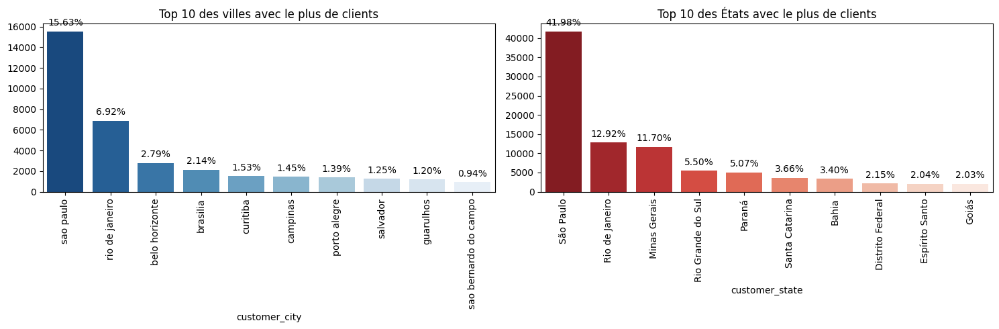

In [225]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calcul du nombre total de clients
total_clients = len(clients)

# Définir la taille de la figure
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Premier sous-graphe : Top 10 des villes avec le plus de clients
top_villes = clients['customer_city'].value_counts().head(10)
ax1 = sns.barplot(x=top_villes.index, y=top_villes.values, ax=axes[0], hue=top_villes.index, palette="Blues_r")
ax1.set_xticks(range(len(top_villes)))  # Ajouter les ticks
ax1.set_title('Top 10 des villes avec le plus de clients')
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)

# Ajout des annotations sur les barres (en %)
for container in ax1.containers:
    ax1.bar_label(container, fmt=lambda x: f"{(x/total_clients)*100:.2f}%", padding=4)

# Deuxième sous-graphe : Top 10 des États avec le plus de clients
top_etats = clients['customer_state'].value_counts().head(10)
ax2 = sns.barplot(x=top_etats.index, y=top_etats.values, ax=axes[1], hue=top_etats.index, palette="Reds_r")
ax2.set_xticks(range(len(top_etats)))  # Ajouter les ticks
ax2.set_title('Top 10 des États avec le plus de clients')
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)

# Ajout des annotations sur les barres (en %)
for container in ax2.containers:
    ax2.bar_label(container, fmt=lambda x: f"{(x/total_clients)*100:.2f}%", padding=4)

# Ajustement des marges
plt.tight_layout()
plt.show()

* ### Carte Choropleth - Répartition des clients par État

In [227]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


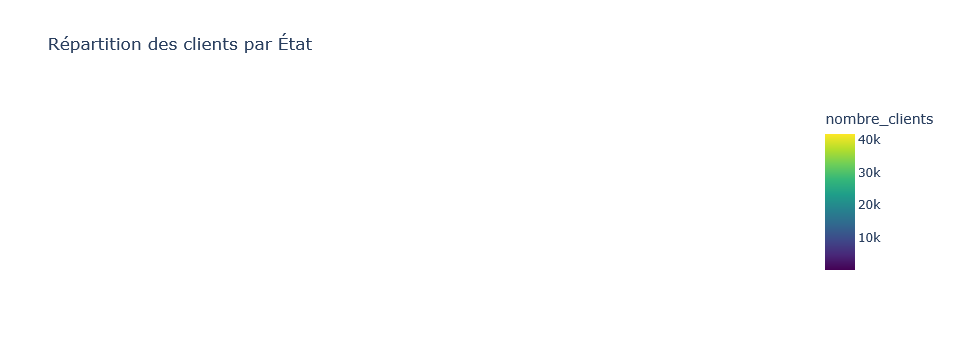

In [228]:
import plotly.express as px

# Créer un DataFrame contenant le nombre de clients par État
clients_par_etat = clients['customer_state'].value_counts().reset_index()
clients_par_etat.columns = ['etat', 'nombre_clients']

# Charger le fichier GeoJSON des États du Brésil
Brazil = "https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/brazil-states.geojson"

# Créer une carte Choropleth
carte_choropleth = px.choropleth(
    clients_par_etat,  # DataFrame contenant les informations
    locations='etat',  # Définir les États comme référence géographique
    geojson=Brazil,  # Fichier GeoJSON du Brésil
    color='nombre_clients',  # Définir la couleur en fonction du nombre de clients
    hover_name='etat',  # Afficher le nom de l'État au survol
    title='Répartition des clients par État',  # Titre de la carte
    color_continuous_scale="Viridis"  # Palette de couleurs
)

# Ajuster l'affichage de la carte
carte_choropleth.update_geos(fitbounds="locations", visible=False)

# Afficher la carte
carte_choropleth.show()

# ____________________________________________________________

# 2.6. Table "olist_sellers_dataset" (Vendeurs) <a id="Table-olist_sellers_dataset-(Vendeurs)"></a>

* ### Chargement des données

In [232]:
# Chargement des données des vendeurs
vendeurs = pd.read_csv('olist_sellers_dataset.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [234]:
vendeurs.shape

(3095, 4)

Ce jeu de données contient 3095 lignes (vendeurs) et 4 colonnes.

* ### Résumé des variables qualitatives

In [237]:
vendeurs.describe(exclude=[np.number])

,seller_id,seller_city,seller_state
count,3095,3095,3095
unique,3095,611,23
top,3442f8959a84dea7ee197c632cb2df15,sao paulo,SP
freq,1,694,1849


* ### Résumé des variables quantitatives

In [239]:
vendeurs.describe()

,seller_zip_code_prefix
count,3095.000000
mean,32291.059451
std,32713.453830
min,1001.000000
25%,7093.500000
50%,14940.000000
75%,64552.500000
max,99730.000000


* ### Types de données

In [241]:
vendeurs.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_state            3095 non-null   object
dtypes: int64(1), object(3)
memory usage: 96.8+ KB


Notre DataFrame contient :
* 1 colonne de type int64
* 3 colonnes de type object.

memory usage: 96.8+ KB : Cela indique que le DataFrame utilise environ 96,8 Kilooctets (KB) de mémoire.

* ### Aperçu rapide des premières lignes du jeu de données

In [244]:
# Affichage des premières lignes du DataFrame des commandes
vendeurs.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


* ### Nombre de valeurs uniques 

In [246]:
# Nombre de valeurs différentes par colonne
vendeurs.nunique()

seller_id                 3095
seller_zip_code_prefix    2246
seller_city                611
seller_state                23
dtype: int64

* Le nombre total de vendeurs dans ce DataFrame est de 3095. Unicité des seller_id (aucun doublon).
* Le nombre de codes postaux pour les vendeurs est de : 2246
* Le nombre de villes pour les vendeurs est de : 611
* Le nombre d'états pour les vendeurs est de : 23

* ### Identification des doublons 

In [249]:
# Vérification du nombre de doublons
nombre_doublons = vendeurs.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 0


* ### Vérification des valeurs manquantes 

In [251]:
print(vendeurs.isnull().sum())

seller_id                 0
seller_zip_code_prefix    0
seller_city               0
seller_state              0
dtype: int64


* ### Nombre de vendeurs par État
Cela nous permet de voir quels États comptent le plus de vendeurs.

In [253]:
# Compter le nombre de vendeurs par état
vendeurs_par_etat = vendeurs['seller_state'].value_counts()

# Afficher les résultats
print(vendeurs_par_etat)

seller_state
SP    1849
PR     349
MG     244
SC     190
RJ     171
RS     129
GO      40
DF      30
ES      23
BA      19
CE      13
PE       9
PB       6
RN       5
MS       5
MT       4
RO       2
SE       2
PI       1
AC       1
MA       1
AM       1
PA       1
Name: count, dtype: int64


* ### Comme pour les clients, Conversion des codes postaux en chaînes de caractères et Transformation des abréviations d'États en noms complets

In [255]:
# Conversion des codes postaux en chaînes de caractères
vendeurs['seller_zip_code_prefix'] = vendeurs['seller_zip_code_prefix'].astype(str)

# Dictionnaire de correspondance des abréviations d'États brésiliens vers leurs noms complets
carte_id_etat = {
    "AC": "Acre",
    "AL": "Alagoas",
    "AP": "Amapá",
    "AM": "Amazonas",
    "BA": "Bahia",
    "CE": "Ceará",
    "DF": "Distrito Federal",
    "ES": "Espírito Santo",
    "GO": "Goiás",
    "MA": "Maranhão",
    "MT": "Mato Grosso",
    "MS": "Mato Grosso do Sul",
    "MG": "Minas Gerais",
    "PA": "Pará",
    "PB": "Paraíba",
    "PR": "Paraná",
    "PE": "Pernambuco",
    "PI": "Piauí",
    "RJ": "Rio de Janeiro",
    "RN": "Rio Grande do Norte",
    "RS": "Rio Grande do Sul",
    "RO": "Rondônia",
    "RR": "Roraima",
    "SC": "Santa Catarina",
    "SP": "São Paulo",
    "SE": "Sergipe",
    "TO": "Tocantins"
}

# Transformation des noms d'États
vendeurs['seller_state'] = vendeurs['seller_state'].apply(lambda x: carte_id_etat.get(x, x))

# Vérifier que la transformation a bien fonctionné
print(vendeurs['seller_state'].value_counts(dropna=False))

seller_state
São Paulo              1849
Paraná                  349
Minas Gerais            244
Santa Catarina          190
Rio de Janeiro          171
Rio Grande do Sul       129
Goiás                    40
Distrito Federal         30
Espírito Santo           23
Bahia                    19
Ceará                    13
Pernambuco                9
Paraíba                   6
Rio Grande do Norte       5
Mato Grosso do Sul        5
Mato Grosso               4
Rondônia                  2
Sergipe                   2
Piauí                     1
Acre                      1
Maranhão                  1
Amazonas                  1
Pará                      1
Name: count, dtype: int64


* ### Visualisation du nombre de vendeurs par ville et par État
Cette visualisation permet de voir la répartition des vendeurs entre les villes et les États.

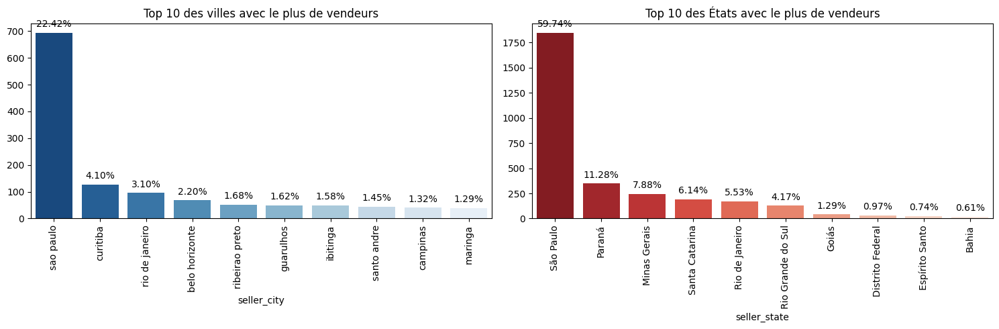

In [257]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calcul du nombre total de vendeurs
total_vendeurs = len(vendeurs)

# Définir la taille de la figure
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Premier sous-graphe : Top 10 des villes avec le plus de vendeurs
top_villes = vendeurs['seller_city'].value_counts().head(10)
ax1 = sns.barplot(x=top_villes.index, y=top_villes.values, ax=axes[0], hue=top_villes.index, palette="Blues_r")
ax1.set_xticks(range(len(top_villes)))  # Ajouter les ticks
ax1.set_title('Top 10 des villes avec le plus de vendeurs')
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)

# Ajout des annotations sur les barres (en %)
for container in ax1.containers:
    ax1.bar_label(container, fmt=lambda x: f"{(x/total_vendeurs)*100:.2f}%", padding=4)


# Deuxième sous-graphe : Top 10 des États avec le plus de vendeurs
top_etats = vendeurs['seller_state'].value_counts().head(10)
ax2 = sns.barplot(x=top_etats.index, y=top_etats.values, ax=axes[1], hue=top_etats.index, palette="Reds_r")
ax2.set_xticks(range(len(top_etats)))  # Ajouter les ticks
ax2.set_title('Top 10 des États avec le plus de vendeurs')
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)

# Ajout des annotations sur les barres (en %)
for container in ax2.containers:
    ax2.bar_label(container, fmt=lambda x: f"{(x/total_vendeurs)*100:.2f}%", padding=4)

# Ajustement des marges
plt.tight_layout()
plt.show()

* ### Carte Choropleth - Répartition des vendeurs par État

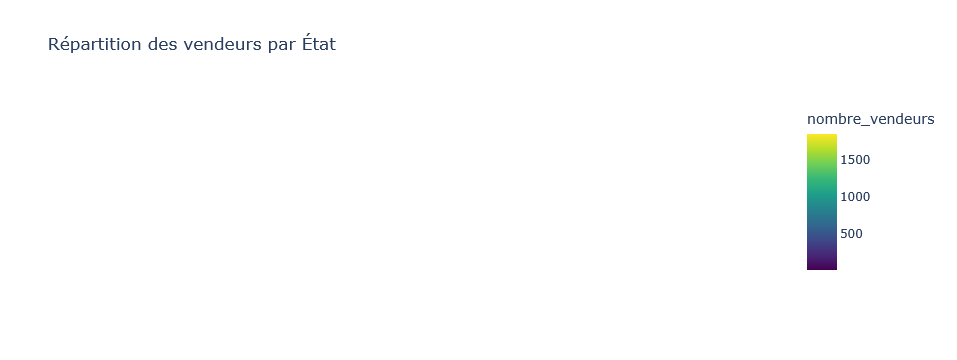

In [259]:
import plotly.express as px

# Créer un DataFrame contenant le nombre de vendeurs par État
vendeurs_par_etat = vendeurs['seller_state'].value_counts().reset_index()
vendeurs_par_etat.columns = ['etat', 'nombre_vendeurs']

# Charger le fichier GeoJSON des États du Brésil
Brazil = "https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/brazil-states.geojson"

# Créer une carte Choropleth
carte_choropleth = px.choropleth(
    vendeurs_par_etat,  # DataFrame contenant les informations
    locations='etat',  # Définir les États comme référence géographique
    geojson=Brazil,  # Fichier GeoJSON du Brésil
    color='nombre_vendeurs',  # Définir la couleur en fonction du nombre de vendeurs
    hover_name='etat',  # Afficher le nom de l'État au survol
    title='Répartition des vendeurs par État',  # Titre de la carte
    color_continuous_scale="Viridis"  # Palette de couleurs
)

# Ajuster l'affichage de la carte
carte_choropleth.update_geos(fitbounds="locations", visible=False)

# Afficher la carte
carte_choropleth.show()

# ____________________________________________________________

# 2.7. Table "olist_order_payments_dataset" (Paiements) <a id="Table-olist_order_payments_dataset-(Paiements)"></a>

* ### Chargement des données

In [263]:
# Chargement des données des paiements
payments = pd.read_csv('olist_order_payments_dataset.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [265]:
payments.shape

(103886, 5)

Ce jeu de données contient 103886 lignes et 5 colonnes.

* ### Résumé des variables qualitatives

In [268]:
payments.describe(exclude=[np.number])

,order_id,payment_type
count,103886,103886
unique,99440,5
top,fa65dad1b0e818e3ccc5cb0e39231352,credit_card
freq,29,76795


Il y a 99 440 identifiants de commande uniques : certaines commandes ont plusieurs paiements.

Carte de crédit ultra dominante (76 795 transactions). C'est le mode de paiement le plus fréquent.

* ### Résumé des variables quantitatives

In [271]:
payments.describe()

,payment_sequential,payment_installments,payment_value
count,103886.000000,103886.000000,103886.000000
mean,1.092679,2.853349,154.100380
std,0.706584,2.687051,217.494064
min,1.000000,0.000000,0.000000
25%,1.000000,1.000000,56.790000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.837500
max,29.000000,24.000000,13664.080000


* payment_sequential max = 29 : Une commande a été réglée en 29 paiements différents.
* payment_installments max = 24 : Un paiement a été fait en 24 fois.
* payment_value max = 13 664.08 : Commande avec montant très élevé.

* ### Types de données

In [274]:
payments.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


Notre DataFrame contient :
* 1 colonne de type float64
* 2 colonnes de type int64
* 2 colonnes de type object.

memory usage: 4.0+ MB : Cela indique que le DataFrame utilise environ 4,0 Mégaooctets (MB) de mémoire.

* ### Aperçu rapide des premières lignes du jeu de données

In [277]:
# Affichage des premières lignes du DataFrame des commandes
payments.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


Les paiements sont souvent en 1 seule fois, sauf quelques cas en plusieurs mensualités.

* ### Vérification des valeurs manquantes 

In [280]:
print(payments.isnull().sum())

order_id                0
payment_sequential      0
payment_type            0
payment_installments    0
payment_value           0
dtype: int64


* ### Identification des doublons 

In [282]:
# Vérification du nombre de doublons
nombre_doublons = payments.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 0


In [283]:
# Vérification des doublons dans la colonne 'order_id'
doublons_order_id = payments['order_id'].duplicated().sum()
print(f"Nombre de doublons dans 'order_id' : {doublons_order_id}")

Nombre de doublons dans 'order_id' : 4446


Aucun doublon total, mais 4 446 "order_id" dupliqués. Cela indique que certaines commandes ont été réglées en plusieurs paiements (ex: une partie en carte de crédit et une autre en bon d’achat). Autremlent dit, Il y a 4446 commandes qui ont plus d’un paiement.

Cela signifie que certains clients fractionnent leurs paiements, ce qui est intéressant pour analyser les comportements de paiement.

**Exemples de commandes avec plusieurs paiements**

In [286]:
# Identification et affichage des premiers duplicatas de 'order_id'
doublons_order_id = payments[payments['order_id'].duplicated(keep=False)].sort_values('order_id')
print("\nPremiers duplicatas de 'order_id' :")
doublons_order_id.head(5)


Premiers duplicatas de 'order_id' :


,order_id,payment_sequential,payment_type,payment_installments,payment_value
80856,0016dfedd97fc2950e388d2971d718c7,2,voucher,1,17.92
89575,0016dfedd97fc2950e388d2971d718c7,1,credit_card,5,52.63
20036,002f19a65a2ddd70a090297872e6d64e,1,voucher,1,44.11
98894,002f19a65a2ddd70a090297872e6d64e,2,voucher,1,33.18
30155,0071ee2429bc1efdc43aa3e073a5290e,2,voucher,1,92.44


* ### Nombre de valeurs uniques 

In [288]:
# Nombre de valeurs différentes par colonne
payments.nunique()

order_id                99440
payment_sequential         29
payment_type                5
payment_installments       24
payment_value           29077
dtype: int64

* La table orders contient 99441 commandes, alors que la table payments n’a que 99440.
Cela suggère qu’il existe une commande qui n’a pas de paiement enregistré.

In [290]:
# Trouvons l'order_id qui est dans orders mais pas dans payments
missing_order = commandes[~commandes["order_id"].isin(payments["order_id"])]
print(missing_order)

                               order_id                       customer_id  \
30710  bfbd0f9bdef84302105ad712db648a6c  86dc2ffce2dfff336de2f386a786e574   

       delai_livraison_jours  retard_livraison_jours  \
30710                     54                      36   

       delai_dernier_achat_jours  heure_commande  mois_commande  \
30710                        893              12              9   

       jour_commande  order_date  
30710              4  2016-09-15  


La commande a été passée le 15 septembre 2016 à 12h.
Le délai de livraison prévu était 54 jours, mais elle a eu 36 jours de retard.
Le dernier achat de ce client remontait à 884 jours avant.

**Paiement en attente ou rejeté? :** Peut-être que le client a tenté un paiement, mais qu’il a été rejeté et n’a jamais été enregistré dans payments.

**Paiement hors système? :** Peut-être que ce paiement a été effectué en dehors des méthodes enregistrées (virement, chèque, bon d’achat).

**Commande offerte ou annulée après livraison? :** Peut-être une commande remboursée ou un produit envoyé gratuitement (geste commercial...).

**Erreur ou donnée manquante? :** Un bug dans la collecte des paiements ? Un problème dans les données ?

* L’explication la plus probable est qu’il y a une commande enregistrée dans orders mais sans paiement associé dans payments. La cause pourrait être un problème de saisie.

* ### Identification des valeurs aberrantes

In [293]:
# Identification des valeurs aberrantes
# Nous utiliserons le Z-score pour identifier les valeurs aberrantes dans les colonnes numériques
from scipy.stats import zscore

numeric_columns = ['payment_sequential', 'payment_installments', 'payment_value']
z_scores = payments[numeric_columns].apply(zscore)
outliers = (z_scores.abs() > 3).sum()
outliers

payment_sequential       906
payment_installments     341
payment_value           1803
dtype: int64

Paiements fractionnés excessivement (sequential > 3 écart-types)

Montants très élevés détectés (payment_value)

* **Recherche des commandes qui ont le plus grand nombre de paiements séquentiels.**

In [296]:
# Regroupement par 'order_id' pour compter le nombre de paiements séquentiels pour chaque commande
comptage_paiements = payments.groupby('order_id').size().reset_index(name='nombre_paiements')

# Recherche des 'order_id' avec le plus grand nombre de paiements séquentiels
max_nombre_paiements = comptage_paiements['nombre_paiements'].max()
clients_avec_max_paiements = comptage_paiements[comptage_paiements['nombre_paiements'] == max_nombre_paiements]

clients_avec_max_paiements

,order_id,nombre_paiements
97261,fa65dad1b0e818e3ccc5cb0e39231352,29


* L'ID de commande du client ayant effectué le plus grand nombre de paiements séquentiels est fa65dad1b0e818e3ccc5cb0e39231352, avec un total de 29 paiements séquentiels.

In [298]:
# Affichage des valeurs uniques de la séquence de paiements
valeurs_uniques_sequential = payments['payment_sequential'].unique()
print(f"Valeurs uniques dans 'payment_sequential' : {valeurs_uniques_sequential}")

# Filtrage et affichage des lignes correspondant à un 'order_id' spécifique
order_id_specifique = 'fa65dad1b0e818e3ccc5cb0e39231352'
details_order_specifique = payments[payments['order_id'] == order_id_specifique]

# Affichage des résultats
print(f"Détails des paiements pour 'order_id' = {order_id_specifique} :")
details_order_specifique.head(10)

Valeurs uniques dans 'payment_sequential' : [ 1  2  4  5  3  8  6  7 10 11 17 19 27 12  9 15 13 14 16 25 22 26 29 28
 18 21 24 23 20]
Détails des paiements pour 'order_id' = fa65dad1b0e818e3ccc5cb0e39231352 :


,order_id,payment_sequential,payment_type,payment_installments,payment_value
4885,fa65dad1b0e818e3ccc5cb0e39231352,27,voucher,1,66.02
9985,fa65dad1b0e818e3ccc5cb0e39231352,4,voucher,1,29.16
14321,fa65dad1b0e818e3ccc5cb0e39231352,1,voucher,1,3.71
17274,fa65dad1b0e818e3ccc5cb0e39231352,9,voucher,1,1.08
19565,fa65dad1b0e818e3ccc5cb0e39231352,10,voucher,1,12.86
23074,fa65dad1b0e818e3ccc5cb0e39231352,2,voucher,1,8.51
24879,fa65dad1b0e818e3ccc5cb0e39231352,25,voucher,1,3.68
28330,fa65dad1b0e818e3ccc5cb0e39231352,5,voucher,1,0.66
29648,fa65dad1b0e818e3ccc5cb0e39231352,6,voucher,1,5.02
32519,fa65dad1b0e818e3ccc5cb0e39231352,11,voucher,1,4.03


* Un client payment_sequential est un client qui effectue une série de paiements échelonnés ou successifs pour une seule commande. Chaque paiement est enregistré avec un numéro de séquence unique (payment_sequential).  Un client a donc effectué 29 paiements distincts pour une seule commande

- **Identification des paiements avec payment_installments == 0**
- **Calcul des statistiques descriptives sur payment_value**
- **Détection des valeurs anormalement élevées dans payment_value**

In [301]:
# Vérification des valeurs de payment_installments égales à 0
installations_zero = payments[payments['payment_installments'] == 0]

# Calcul des statistiques descriptives pour 'payment_value'
summary_stats = payments['payment_value'].describe()

# Vérification des valeurs élevées dans 'payment_value'
valeurs_elevees_paiement = payments[payments['payment_value'] > summary_stats.loc['75%'] + 3 * summary_stats.loc['std']]

# Affichage des résultats
installations_zero, valeurs_elevees_paiement

(                               order_id  payment_sequential payment_type  \
 46982  744bade1fcf9ff3f31d860ace076d422                   2  credit_card   
 79014  1a57108394169c0b47d8f876acc9ba2d                   2  credit_card   
 
        payment_installments  payment_value  
 46982                     0          58.69  
 79014                     0         129.94  ,
                                 order_id  payment_sequential payment_type  \
 160     886b114d034f4ac1d39d964c1b2a8182                   1  credit_card   
 167     62d9b911d7c56cf455f660eecb8ddd3a                   1  credit_card   
 235     f86d7bc39aab05299691322044b63bb2                   1      voucher   
 247     4ff8e28200e5a7a50b448cfaaf1f8ed3                   1  credit_card   
 359     ce6d150fb29ada17d2082f4847107665                   1  credit_card   
 ...                                  ...                 ...          ...   
 103622  b0b0d3285e59abf2f6c9d7e1bf761323                   1  credit_card   
 103

* **Vérification des valeurs payment_installments égales à 0 :** Deux enregistrements ont des valeurs de payment_installments égales à 0, ce qui semble anormal puisque cela indique des paiements échelonnés à 0 versements. Théoriquement, le nombre de mensualités doit être ≥ 1 (au moins un paiement).
Si des paiements ont 0 mensualité, cela peut être une erreur de saisie ou une valeur mal enregistrée. C’est étrange, mais vu le faible nombre, ce n’est pas un gros problème.

* **Calcul des statistiques descriptives pour payment_value :** 1 803 enregistrements ont des valeurs de payment_value très élevées (au-delà de 3 écarts-types de la moyenne), allant jusqu'à 13664.08.

* **Détection des valeurs anormalement élevées dans payment_value :** Identifier les paiements extrêmement élevés, c'est-à-dire ceux qui dépassent :

                  Seuil = 𝑄3+3×Ecart-Type
       Avec Q3 = 171.84 et Écart-Type = 217.49, cela donne un seuil de :
                  171.84+(3×217.49)=824.31

Donc, toute transaction avec payment_value > 824.31 est considérée comme une valeur extrême.

En supposant que les valeurs élevées soient valides, aucune modification ne sera apportée. Si nécessaire, nous pouvons transformer ou normaliser les données.

In [303]:
# Suppression des enregistrements avec payment_installments égales à 0

#payments = payments[payments['payment_installments'] != 0]

* ### Analyse de la somme des paiements 
cela confirmera certainement que les cartes de crédit représentent la plus grosse part des montants encaissés.

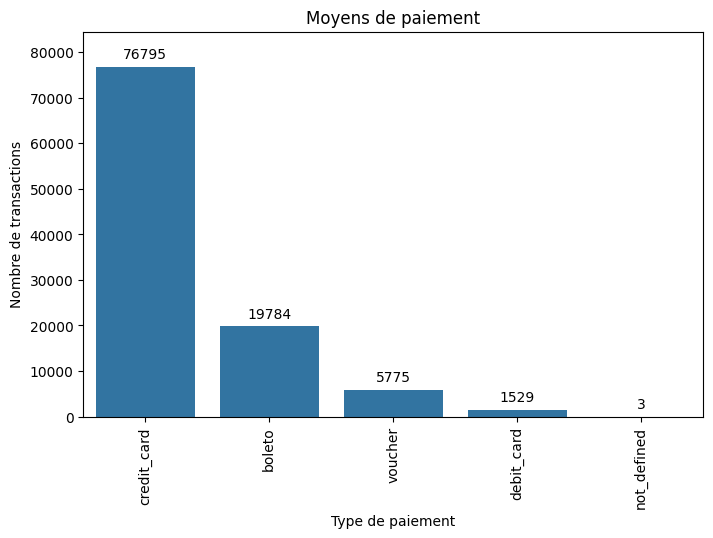

In [305]:
# Comptage des différents types de moyens de paiement
payment_counts = payments['payment_type'].value_counts()

# Création de la figure pour la représentation graphique
plt.figure(figsize=(8, 5))

# Création du graphique à barres pour les moyens de paiement
ax = sns.barplot(x=payment_counts.index, y=payment_counts.values)

# Ajout des étiquettes de valeur sur les barres
ax.bar_label(ax.containers[0], padding=4)  

plt.title('Moyens de paiement')   # Ajout du titre du graphique
plt.ylabel('Nombre de transactions')  # Ajout de l'étiquette de l'axe des y
plt.xlabel('Type de paiement')  # Ajout de l'étiquette de l'axe des x
plt.xticks(rotation=90)  # Rotation des étiquettes de l'axe des x pour une meilleure lisibilité
ax.margins(y=0.1)  # Ajout de marges pour améliorer l'affichage

# Affichage du graphique
plt.show()

Le graphique montre clairement que la carte de crédit est de loin le moyen de paiement préféré, suivie par le boleto et le voucher. Les cartes de débit sont moins utilisées, et les cas non définis sont rares. Cette information peut être utile pour comprendre les préférences des clients en matière de paiement et pour orienter les stratégies de paiement de l'entreprise.

* ### Restructuration et agrégation des données

Pivot table : nous allons transformer le tableau pour regrouper les paiements par commande et par type de paiement, par:
* Fusion des paiements "credit_card" et "debit_card" en une seule colonne "CB".
Suppression des colonnes d’origine.

In [308]:
# Calculer le nombre maximal d'installments pour chaque commande
max_installments = payments.groupby('order_id')['payment_installments'].max().to_frame()

# Créer un tableau croisé dynamique pour obtenir une ligne par commande avec les types de paiement comme colonnes
payments_pivot = pd.pivot_table(payments, index='order_id', columns='payment_type', values='payment_value', aggfunc='sum')

# Remplacer les valeurs NaN par 0
payments_pivot.fillna(0, inplace=True)

# Fusionner les paiements par carte de crédit et carte de débit en une seule colonne "CB"
payments_pivot["CB"] = payments_pivot.get("credit_card", 0) + payments_pivot.get("debit_card", 0)

# Supprimer les anciennes colonnes "credit_card" et "debit_card"
payments_pivot.drop(columns=["credit_card", "debit_card"], inplace=True, errors='ignore')

# Fusionner le tableau croisé avec le DataFrame des max_installments
payments = payments_pivot.merge(max_installments, left_index=True, right_index=True)

# Réinitialiser l'index pour convertir 'order_id' en colonne
payments.reset_index(inplace=True)

# Afficher les 5 premières lignes du DataFrame final pour vérification
print(f"Nombre total de lignes dans le DataFrame des paiements : {len(payments)}")
payments.head()

Nombre total de lignes dans le DataFrame des paiements : 99440


,order_id,boleto,not_defined,voucher,CB,payment_installments
0,00010242fe8c5a6d1ba2dd792cb16214,0.0,0.0,0.0,72.19,2
1,00018f77f2f0320c557190d7a144bdd3,0.0,0.0,0.0,259.83,3
2,000229ec398224ef6ca0657da4fc703e,0.0,0.0,0.0,216.87,5
3,00024acbcdf0a6daa1e931b038114c75,0.0,0.0,0.0,25.78,2
4,00042b26cf59d7ce69dfabb4e55b4fd9,0.0,0.0,0.0,218.04,3


Maintenant, la colonne "CB" regroupe bien credit_card + debit_card et les anciennes colonnes ont été supprimées. 

* ### Graphique de la somme totale des paiements pour chaque type de paiement.
Pour vérifier la somme totale associée à chaque moyen de paiement.

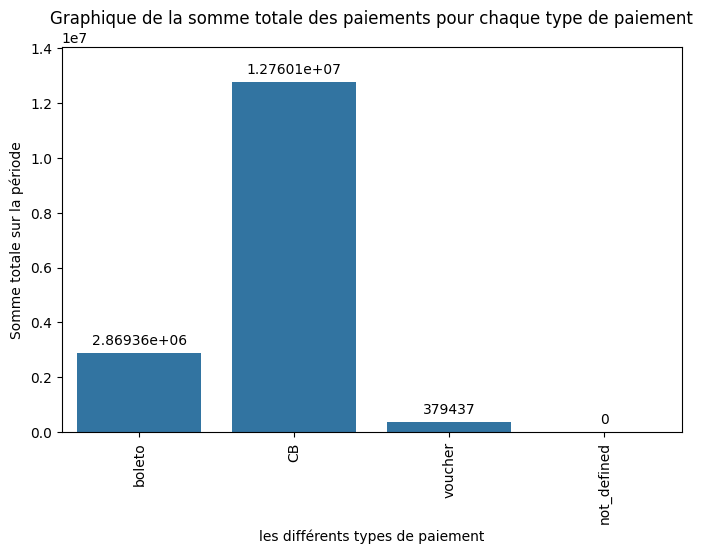

In [311]:
# Calcul de la somme des paiements par type, en utilisant la colonne "CB" fusionnée
types_de_paiement = ['boleto', 'CB', 'voucher', 'not_defined']
somme_par_type = payments[types_de_paiement].sum()

# Création de la figure pour la représentation graphique
plt.figure(figsize=(8, 5))

# Création du graphique à barres pour la somme totale par moyen de paiement
ax = sns.barplot(x=somme_par_type.index, y=somme_par_type.values)

# Ajout des étiquettes de valeur sur les barres
ax.bar_label(ax.containers[0], padding=4)

plt.title('Graphique de la somme totale des paiements pour chaque type de paiement')  # Ajout du titre du graphique
plt.ylabel('Somme totale sur la période')  # Ajout de l'étiquette de l'axe des y
plt.xlabel('les différents types de paiement')
plt.xticks(rotation=90)  # Rotation des étiquettes de l'axe des x pour une meilleure lisibilité
ax.margins(y=0.1)  # Ajout de marges pour améliorer l'affichage

# Affichage du graphique
plt.show()

In [312]:
# Renommage des colonnes
payments.rename(columns={
    'boleto': 'Paiement par Billets',
    'voucher': 'Paiement par Bon',
    'CB': 'Carte Bancaire',
    'not_defined': 'Non Défini',
    'payment_installments': 'Paiements échelonnés'
}, inplace=True)

# Suppression des colonnes 'Non Défini','Paiement par Billets', 'Paiement par Bon', 'Carte Bancaire' (si elles sont inutiles pour le moment)
payments.drop(columns=['Non Défini','Paiement par Billets', 'Paiement par Bon', 'Carte Bancaire'], inplace=True)

# Affichage des premières lignes du DataFrame pour vérifier les modifications
payments.head()

,order_id,Paiements échelonnés
0,00010242fe8c5a6d1ba2dd792cb16214,2
1,00018f77f2f0320c557190d7a144bdd3,3
2,000229ec398224ef6ca0657da4fc703e,5
3,00024acbcdf0a6daa1e931b038114c75,2
4,00042b26cf59d7ce69dfabb4e55b4fd9,3


# ____________________________________________________________

# 2.8. Table "olist_geolocation_dataset" (Géolocalisation) <a id="Table-olist_geolocation_dataset-(Géolocalisation)"></a>

* ### Chargement des données

In [316]:
# Chargement des données de géolocalisation
geolocalisation = pd.read_csv('olist_geolocation_dataset.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [318]:
geolocalisation.shape

(1000163, 5)

Ce jeu de données contient 1 000 163 lignes et 5 colonnes.

* ### Résumé des variables qualitatives

In [321]:
geolocalisation.describe(exclude=[np.number])

,geolocation_city,geolocation_state
count,1000163,1000163
unique,8011,27
top,sao paulo,SP
freq,135800,404268


Statistiques descriptives pour les colonnes non numériques, comme les villes et les états :

* geolocation_city : Il y a 8011 villes uniques, et la ville la plus fréquente est sao paulo (135 800 occurrences).
* geolocation_state : Il y a 27 états uniques, et l'état le plus fréquent est SP (404 268 occurrences).

* ### Résumé des variables quantitatives

In [324]:
geolocalisation.describe()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
count,1.000163e+06,1.000163e+06,1.000163e+06
mean,3.657417e+04,-2.117615e+01,-4.639054e+01
std,3.054934e+04,5.715866e+00,4.269748e+00
min,1.001000e+03,-3.660537e+01,-1.014668e+02
25%,1.107500e+04,-2.360355e+01,-4.857317e+01
50%,2.653000e+04,-2.291938e+01,-4.663788e+01
75%,6.350400e+04,-1.997962e+01,-4.376771e+01
max,9.999000e+04,4.506593e+01,1.211054e+02


statistiques descriptives pour les colonnes numériques, telles que les codes postaux, les latitudes et les longitudes.

* geolocation_zip_code_prefix : Les valeurs vont de 1000 à 99990, représentant les préfixes de codes postaux.
* geolocation_lat : La latitude varie entre -36.60537 et 45.06593, avec une moyenne autour de -21.176.
* geolocation_lng : La longitude varie entre -101.4668 et 121.1054, avec une moyenne autour de -46.3905.

* ### Types de données

In [327]:
geolocalisation.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


Notre DataFrame contient :
* 2 colonnes de type float
* 1 colonne de type int
* 2 colonnes de type object.

memory usage: 38.2+ MB : Cela indique que le DataFrame utilise environ 38,2 Mégaooctets (MB) de mémoire.

* ### Aperçu rapide des premières lignes du jeu de données

In [330]:
# Affichage des premières lignes du DataFrame des commandes
geolocalisation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


* ### Vérification des valeurs manquantes 

In [332]:
print(geolocalisation.isnull().sum())

geolocation_zip_code_prefix    0
geolocation_lat                0
geolocation_lng                0
geolocation_city               0
geolocation_state              0
dtype: int64


Les données sont complètes.

* ### Identification et traitement des doublons 

In [335]:
# Vérification du nombre de doublons
nombre_doublons = geolocalisation.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 261831


261831 doublons ont été trouvés, ce qui représente une proportion importante du dataset.

In [337]:
# Suppression des doublons
geolocalisation = geolocalisation.drop_duplicates()

# Vérification de la taille du dataset après suppression
cleaned_data_size = geolocalisation.shape
cleaned_data_size

(738332, 5)

La taille du dataset est réduite de 1 000 163 à 738 332 lignes après la suppression des doublons.

* ### Filtrage des coordonnées géographiques hors plage
**Latitude :**
* Le Brésil s'étend approximativement de la latitude **-33.7500** (au sud, près de la frontière avec l'Argentine et l'Uruguay) à **5.2725** (au nord, près de la frontière avec la Guyane).

**Longitude :**
* En termes de longitude, le Brésil s'étend d'environ **-73.9831** (à l'est, près de l'océan Atlantique) à **-34.7939** (à l'ouest, près de la frontière avec la Bolivie et le Pérou).

* Ces valeurs sont des limites géographiques qui couvrent la quasi-totalité du territoire du Brésil. Elles vont être utilisées pour exclure des données qui seraient situées en dehors de ce pays, comme des erreurs de géolocalisation ou des valeurs mal saisies.

In [340]:
# Définir la plage valide pour les latitudes et longitudes au Brésil
lat_min, lat_max = -33.7500, 5.2725
lng_min, lng_max = -73.9831, -34.7939

# Filtrer les lignes avec des latitudes et longitudes en dehors de la plage valide
hors_plage = geolocalisation[
    (geolocalisation['geolocation_lat'] < lat_min) | (geolocalisation['geolocation_lat'] > lat_max) |
    (geolocalisation['geolocation_lng'] < lng_min) | (geolocalisation['geolocation_lng'] > lng_max)
]

# Résumé des valeurs hors plage
nombre_hors_plage = hors_plage.shape[0]
nombre_hors_plage, hors_plage.head()

(34,
         geolocation_zip_code_prefix  geolocation_lat  geolocation_lng  \
 387565                        18243        28.008978       -15.536867   
 513631                        28165        41.614052        -8.411675   
 513643                        28155       -34.586422       -58.732101   
 513754                        28155        42.439286        13.820214   
 514429                        28333        38.381672        -6.328200   
 
                geolocation_city geolocation_state  
 387565  bom retiro da esperanca                SP  
 513631      vila nova de campos                RJ  
 513643              santa maria                RJ  
 513754              santa maria                RJ  
 514429                   raposo                RJ  )

34 lignes ont des coordonnées géographiques hors de la plage spécifiée, ces lignes ont été isolées dans le DataFrame hors_plage.

* ### Suppression des valeurs hors plage

In [343]:
# Suppression des lignes avec des valeurs hors plage
geolocalisation = geolocalisation[
    (geolocalisation['geolocation_lat'] >= lat_min) & (geolocalisation['geolocation_lat'] <= lat_max) &
    (geolocalisation['geolocation_lng'] >= lng_min) & (geolocalisation['geolocation_lng'] <= lng_max)
]

# Forme finale du jeu de données nettoyé
geolocalisation.shape

(738298, 5)

Nous avons filtré le DataFrame pour supprimer les lignes où les coordonnées sont hors plage.

Résultat : Après cette opération, le DataFrame contient désormais 738 298 lignes.

* ### Nombre de valeurs uniques

In [346]:
# Nombre de valeurs différentes par colonne
geolocalisation.nunique()

geolocation_zip_code_prefix     19010
geolocation_lat                717326
geolocation_lng                717579
geolocation_city                 8006
geolocation_state                  27
dtype: int64

* geolocation_zip_code_prefix : 19 015 codes postaux différents.
* geolocation_lat et geolocation_lng : 717360 et 717613 valeurs uniques, respectivement.
* geolocation_city : 8 011 villes uniques.
* geolocation_state : 27 états uniques.

* ### Extraction des valeurs uniques pour les villes et états
Le but est d'obtenir les valeurs uniques des colonnes geolocation_city et geolocation_state.

In [349]:
# Valeurs uniques des colonnes ville et état
unique_cities = geolocalisation['geolocation_city'].unique()
unique_states = geolocalisation['geolocation_state'].unique()

unique_cities[:10], unique_states

(array(['sao paulo', 'são paulo', 'sao bernardo do campo', 'jundiaí',
        'taboão da serra', 'sãopaulo', 'sp', 'sa£o paulo',
        'sao jose dos campos', 'osasco'], dtype=object),
 array(['SP', 'RN', 'AC', 'RJ', 'ES', 'MG', 'BA', 'SE', 'PE', 'AL', 'PB',
        'CE', 'PI', 'MA', 'PA', 'AP', 'AM', 'RR', 'DF', 'GO', 'RO', 'TO',
        'MT', 'MS', 'RS', 'PR', 'SC'], dtype=object))

* Les 10 premières villes uniques : ['sao paulo', 'são paulo', 'sao bernardo do campo', ...]
* Les états : ['SP', 'RN', 'AC', 'RJ', 'ES', 'MG', 'BA', ...]

Nous observons :
* différentes variantes de "São Paulo" (sao paulo, são paulo, sãopaulo, sa£o paulo, etc.)
* Une entrée incorrecte sp qui devrait probablement être "São Paulo".

### **Conversion et nettoyage des noms de villes**

**Conversion en chaînes de caractères**
* Parfois, les noms de villes peuvent être stockés sous forme de bytes (b'...' en Python).
* Si une valeur est au format bytes, on la décode en chaîne UTF-8.
* Sinon, on s'assure que la valeur est bien convertie en string avec str(x).
* Cette étape garantit que toutes les valeurs sont manipulables sans erreur.

**Fonction de nettoyage des noms de villes**
* *re.sub(r'\W+', '', city_name):*
* Supprime tous les caractères non alphanumériques (\W signifie tout sauf [a-zA-Z0-9_]).
* Exemple : "São Paulo!" devient "SãoPaulo".

*.strip().lower() :*
* Supprime les espaces avant/après.
* Convertit en minuscules pour uniformiser ("SãoPaulo" → "saopaulo").

**Application du nettoyage aux colonnes**
* On applique la fonction clean_city_name() pour normaliser les noms de villes dans les deux tables (clients et geolocalisation).

In [353]:
import re

# Conversion en chaînes de caractères et nettoyage des colonnes
geolocalisation['geolocation_city'] = geolocalisation['geolocation_city'].apply(lambda x: x.decode('utf-8') if isinstance(x, bytes) else str(x))

# Fonction de nettoyage des noms de villes
def clean_city_name(city_name):
    return re.sub(r'\W+', '', city_name).strip().lower()

# Application de la fonction de nettoyage
clients['customer_city_clean'] = clients['customer_city'].apply(lambda x: clean_city_name(str(x)))
geolocalisation['geolocation_city_clean'] = geolocalisation['geolocation_city'].apply(lambda x: clean_city_name(str(x)))

* ### Agrégation des données par ville (code postal)
Nous voulons grouper les données par ville (code postal) et calculer la moyenne des latitudes et longitudes.

* Résultat : Le DataFrame sera agrégé par ville (code postal), avec les coordonnées moyennes et les états associés.
    
    * L'intérêt de calculer la moyenne des latitudes et longitudes réside dans le fait que, souvent dans des bases de données géographiques, plusieurs points peuvent être associés à une même ville. Par exemple, une ville peut avoir plusieurs coordonnées GPS associées à différents lieux (magasins, entrepôts, points de vente, etc.)
    
    * Nous regroupons donc ici toutes les données qui appartiennent à la même ville. Par exemple, si on a plusieurs enregistrements pour "Sao Paulo", avec des coordonnées différentes pour différents lieux dans "Sao Paulo", le code va regrouper toutes les données ayant pour geolocation_city le nom "Sao Paulo", puis effectuer une opération (ici la moyenne) sur ces coordonnées.
    
    * la moyenne des latitudes et longitudes permettra de trouver un point central de la ville. C'est une approximation de l'emplacement "moyen" ou "central" de la ville, en tenant compte de tous les points géographiques associés.

In [355]:
# Grouper les données par code postal et calculer la moyenne des coordonnées géographiques
geolocalisation = geolocalisation.groupby('geolocation_zip_code_prefix').agg({
    'geolocation_lat': 'mean',  # Calcul de la moyenne de la latitude
    'geolocation_lng': 'mean',   # Calcul de la moyenne de la longitude
    'geolocation_city': 'unique',  # Conservation des noms de ville uniques
    'geolocation_state': 'unique'  # Conservation des états uniques
}).reset_index()  # Garder l'index sous forme de colonne pour la fusion

* ### Création de la carte interactive avec Folium

In [357]:
!pip install folium

In [358]:
import folium
from tqdm import tqdm

# Initialiser la carte avec la première coordonnée et un niveau de zoom de 3
m = folium.Map(location=[geolocalisation['geolocation_lat'].iloc[0], geolocalisation['geolocation_lng'].iloc[0]], zoom_start=3)

# Ajouter des cercles pour chaque coordonnée dans geolocalisation
for lat, lon, city in tqdm(zip(geolocalisation['geolocation_lat'], geolocalisation['geolocation_lng'], geolocalisation['geolocation_city']), total=len(geolocalisation)):
    folium.Circle(location=[lat, lon], radius=10, popup=city).add_to(m)

# Afficher la carte
m

100%|██████████| 19010/19010 [00:06<00:00, 3012.93it/s]


Nous pouvons observer que tout les points son principalement au Brésil.

In [360]:
# Réinitialiser l'index et supprimer l'ancien index
#geolocalisation.reset_index(drop=True, inplace=True)

# Afficher les premières lignes du DataFrame
#geolocalisation.head()

# ____________________________________________________________

# 2.9. Table "olist_order_reviews_dataset" (Avis clients) <a id="Table-olist_order_reviews_dataset-(Avis clients)"></a>

* ### Chargement des données

In [364]:
# Chargement des données des avis
reviews = pd.read_csv('olist_order_reviews_dataset.csv')

* ### Dimensions du dataset (nombre de lignes et de colonnes)

In [366]:
reviews.shape

(99224, 7)

Ce jeu de données contient 99224 lignes et 7 colonnes.

* ### Résumé des variables qualitatives

In [369]:
reviews.describe(exclude=[np.number])

,review_id,order_id,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
count,99224,99224,11568,40977,99224,99224
unique,98410,98673,4527,36159,636,98248
top,7b606b0d57b078384f0b58eac1d41d78,c88b1d1b157a9999ce368f218a407141,Recomendo,Muito bom,2017-12-19 00:00:00,2017-06-15 23:21:05
freq,3,3,423,230,463,4


statistiques descriptives sur les colonnes non numériques (type object)

* review_id et order_id ont quelques doublons (car unique < count).
* review_comment_title et review_comment_message ont beaucoup de valeurs manquantes.
* review_creation_date est sur 636 jours différents, ce qui montre que plusieurs avis ont été créés à la même date, et sont répartis sur plusieurs années.

* ### Résumé des variables quantitatives

In [372]:
reviews.describe()

,review_score
count,99224.000000
mean,4.086421
std,1.347579
min,1.000000
25%,4.000000
50%,5.000000
75%,5.000000
max,5.000000


Statistiques descriptives pour les colonnes numériques.

* La moyenne des avis est 4.08/5, plutôt positive.
* 50% des avis sont des 5 étoiles.
* Il y a des notes très basses (1 étoile), ce qui peut être intéressant à analyser.

* ### Types de données

In [375]:
reviews.info()
pd.set_option('display.max_columns', None) # pour afficher toutes les colonnes 
pd.set_option('display.max_rows', 100) # pour afficher 100 lignes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     11568 non-null  object
 4   review_comment_message   40977 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


Notre DataFrame contient :
* 1 colonne de type int64
* 6 colonnes de type object.

memory usage: 5.3+ MB : Cela indique que le DataFrame utilise environ 5,3 Mégaooctets (MB) de mémoire.

* Les dates sont stockées sous forme de texte (object), il faudra les convertir en datetime

* ### Aperçu rapide des premières lignes du jeu de données

In [378]:
# Affichage des premières lignes du DataFrame des commandes
reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


* Beaucoup d’avis n’ont ni titre ni message, ils sont juste une note.
* La colonne review_answer_timestamp est toujours postérieure à review_creation_date, ce qui est logique.

* ### Conversion des dates

In [381]:
# Conversion des dates en format datetime
reviews['review_creation_date'] = pd.to_datetime(reviews['review_creation_date'])
reviews['review_answer_timestamp'] = pd.to_datetime(reviews['review_answer_timestamp'])

# Vérification
print(reviews.dtypes)
print(reviews.head())

review_id                          object
order_id                           object
review_score                        int64
review_comment_title               object
review_comment_message             object
review_creation_date       datetime64[ns]
review_answer_timestamp    datetime64[ns]
dtype: object
                          review_id                          order_id  \
0  7bc2406110b926393aa56f80a40eba40  73fc7af87114b39712e6da79b0a377eb   
1  80e641a11e56f04c1ad469d5645fdfde  a548910a1c6147796b98fdf73dbeba33   
2  228ce5500dc1d8e020d8d1322874b6f0  f9e4b658b201a9f2ecdecbb34bed034b   
3  e64fb393e7b32834bb789ff8bb30750e  658677c97b385a9be170737859d3511b   
4  f7c4243c7fe1938f181bec41a392bdeb  8e6bfb81e283fa7e4f11123a3fb894f1   

   review_score review_comment_title  \
0             4                  NaN   
1             5                  NaN   
2             5                  NaN   
3             5                  NaN   
4             5                  NaN   

            

* ### Vérification des valeurs manquantes 

In [383]:
print(reviews.isnull().sum())

review_id                      0
order_id                       0
review_score                   0
review_comment_title       87656
review_comment_message     58247
review_creation_date           0
review_answer_timestamp        0
dtype: int64


* review_id, order_id et review_score sont toujours remplis (pas de valeurs manquantes).
* review_comment_title (87656) et review_comment_message (58247) ont beaucoup de valeurs manquantes. **Ces colonnes ne sont pas très exploitables.**

* ### Nombre de valeurs uniques 

In [386]:
# Nombre de valeurs différentes par colonne
reviews.nunique()

review_id                  98410
order_id                   98673
review_score                   5
review_comment_title        4527
review_comment_message     36159
review_creation_date         636
review_answer_timestamp    98248
dtype: int64

* review_id : 98 410 valeurs uniques (814 doublons: voir ci-dessous)
* order_id : 98 673 valeurs uniques (551 doublons: voir ci-dessous)
* review_score : 5 valeurs possibles (1 à 5)
* review_comment_message : 36 159 valeurs uniques

Certains review_id et order_id sont dupliqués, ce qui signifie que plusieurs avis existent pour une même commande.

* ### Identification des doublons 

In [389]:
# Vérification du nombre de doublons
nombre_doublons = reviews.duplicated().sum()
print(f"Le nombre total de doublons dans cette table est : {nombre_doublons}")

Le nombre total de doublons dans cette table est : 0


In [390]:
# Vérification des doublons dans la colonne 'review_id'
doublons_review_id = reviews['review_id'].duplicated().sum()
print(f"Nombre de doublons dans 'review_id' : {doublons_review_id}")

# Vérification des doublons dans la colonne 'order_id'
doublons_order_id = reviews['order_id'].duplicated().sum()
print(f"Nombre de doublons dans 'order_id' : {doublons_order_id}")

Nombre de doublons dans 'review_id' : 814
Nombre de doublons dans 'order_id' : 551


* .duplicated().sum() sur review_id détecte les avis répétés.
* order_id a 551 doublons

Certains avis sont répétés pour une même commande

* **Exemples de review_id en double**

In [393]:
# Identification et affichage des premiers duplicatas de 'review_id'
doublons_review_id = reviews[reviews['review_id'].duplicated(keep=False)].sort_values('review_id')
print("\nPremiers duplicatas de 'review_id' :")
doublons_review_id.head()


Premiers duplicatas de 'review_id' :


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
46678,00130cbe1f9d422698c812ed8ded1919,dfcdfc43867d1c1381bfaf62d6b9c195,1,NaN,"O cartucho ""original HP"" 60XL não é reconhecid...",2018-03-07,2018-03-20 18:08:23
29841,00130cbe1f9d422698c812ed8ded1919,04a28263e085d399c97ae49e0b477efa,1,NaN,"O cartucho ""original HP"" 60XL não é reconhecid...",2018-03-07,2018-03-20 18:08:23
90677,0115633a9c298b6a98bcbe4eee75345f,78a4201f58af3463bdab842eea4bc801,5,NaN,NaN,2017-09-21,2017-09-26 03:27:47
63193,0115633a9c298b6a98bcbe4eee75345f,0c9850b2c179c1ef60d2855e2751d1fa,5,NaN,NaN,2017-09-21,2017-09-26 03:27:47
92876,0174caf0ee5964646040cd94e15ac95e,f93a732712407c02dce5dd5088d0f47b,1,NaN,Produto entregue dentro de embalagem do fornec...,2018-03-07,2018-03-08 03:00:53


Les review_id en double contiennent les mêmes messages aux mêmes heures, même s'ils ne concernent pas la même commande.

Les mêmes review_id peuvent en effet être associés à des commandes différentes, mais avec le même message et la même heure d’envoi.

* **Exemples de order_id en double**

In [396]:
# Identification et affichage des premiers duplicatas de 'order_id'
doublons_order_id = reviews[reviews['order_id'].duplicated(keep=False)].sort_values('order_id')
print("\nPremiers duplicatas de 'order_id' :")
doublons_order_id.head()


Premiers duplicatas de 'order_id' :


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
25612,89a02c45c340aeeb1354a24e7d4b2c1e,0035246a40f520710769010f752e7507,5,NaN,NaN,2017-08-29,2017-08-30 01:59:12
22423,2a74b0559eb58fc1ff842ecc999594cb,0035246a40f520710769010f752e7507,5,NaN,Estou acostumada a comprar produtos pelo barat...,2017-08-25,2017-08-29 21:45:57
22779,ab30810c29da5da8045216f0f62652a2,013056cfe49763c6f66bda03396c5ee3,5,NaN,NaN,2018-02-22,2018-02-23 12:12:30
68633,73413b847f63e02bc752b364f6d05ee9,013056cfe49763c6f66bda03396c5ee3,4,NaN,NaN,2018-03-04,2018-03-05 17:02:00
854,830636803620cdf8b6ffaf1b2f6e92b2,0176a6846bcb3b0d3aa3116a9a768597,5,NaN,NaN,2017-12-30,2018-01-02 10:54:06


Les order_id en double peuvent indiquer qu'une même commande (order_id) peut avoir plusieurs avis différents.

* ### Transformation de review_comment_message en variable binaire et Suppression des colonnes inutiles

In [399]:
# Transformation de la colonne 'review_comment_message' en indicateur binaire
reviews['review_comment_message'] = reviews['review_comment_message'].apply(lambda x: 1 if isinstance(x, str) else 0)

# Suppression des colonnes inutiles
colonnes_a_supprimer = [
    'review_id',                  # Difficile à utiliser pour les analyses
    'review_comment_title',       # Presque vide
    'review_creation_date',       # Toujours à minuit, souvent sans message
    'review_answer_timestamp',    # Réponse à quoi s'il n'y a rien ?
    'review_comment_message'      # Peu utile finalement 
]

reviews.drop(columns=colonnes_a_supprimer, inplace=True)

On garde seulement order_id et review_score.

* ### Agrégation des avis par commande

In [402]:
#Soit on garde la plus petite note (min()) pour chaque commande?

In [403]:
# Groupement par 'order_id' en utilisant la fonction min() pour chaque groupe
#reviews = reviews.groupby('order_id').min().reset_index()

# Affichage des premières lignes pour vérifier les modifications
#reviews.head()

In [404]:
#Soit on prend mean() pour avoir une note moyenne pour chaque commande, plutôt que de garder uniquement la note la plus basse (min())?

In [405]:
# Groupement par 'order_id' en utilisant la fonction mean() pour avoir une seule note moyenne pour chaque commande
reviews = reviews.groupby('order_id', as_index=False).agg({'review_score': 'mean'})

# Affichage des premières lignes pour vérifier les modifications
reviews.head()

,order_id,review_score
0,00010242fe8c5a6d1ba2dd792cb16214,5.0
1,00018f77f2f0320c557190d7a144bdd3,4.0
2,000229ec398224ef6ca0657da4fc703e,5.0
3,00024acbcdf0a6daa1e931b038114c75,4.0
4,00042b26cf59d7ce69dfabb4e55b4fd9,5.0


Si chaque order_id a plusieurs avis associés, le fait de les regrouper permet d'obtenir une note moyenne par commande.

Nous avons bien agrégé les scores d'avis dans la table reviews au niveau des commandes (avec groupby('order_id').agg({'review_score': 'mean'}))

* ### Vérification si les avis négatifs sont fréquents ou rares

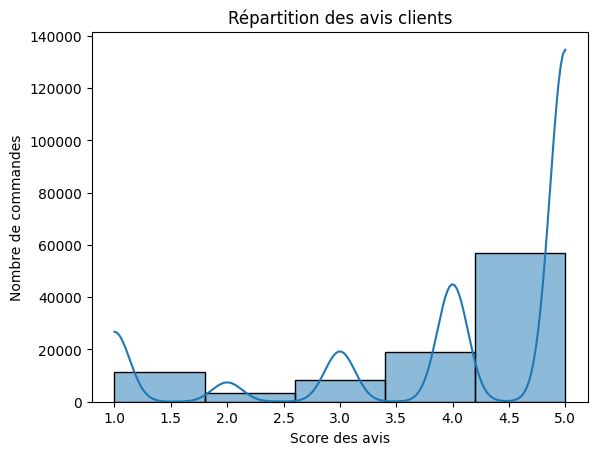

In [408]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.histplot(reviews['review_score'], bins=5, kde=True)
plt.xlabel("Score des avis")
plt.ylabel("Nombre de commandes")
plt.title("Répartition des avis clients")
plt.show()

# ____________________________________________________________

# 3. Jointure des tables <a id="Jointure-des-tables"></a>

* **Table principale :** La table olist_orders_dataset est centrale car elle relie clients, commandes et autres informations.

* Elle sera base de la fusion
    * Toutes les autres tables sont reliées directement ou indirectement à commandes via order_id.
    * Un client peut passer plusieurs commandes, mais l'unité d'analyse principale ici semble être la commande.

* Elle contient les informations temporelles clés
    * La date d'achat (order_purchase_timestamp)
    * La date d'approbation du paiement (order_approved_at)
    * La date de livraison (order_delivered_customer_date)
    * Ces informations sont essentielles pour le calcul des indicateurs RFM et l’analyse du comportement client.

* Elle permet de relier toutes les autres entités
    * clients via customer_id
    * articles via order_id
    * payments via order_id
    * reviews via order_id
    * vendeurs via seller_id (indirectement via articles)
    * products via product_id (indirectement via articles)

**Mais d'abord, nous allons :**
* récupèrer les coordonnées GPS des clients et vendeurs en utilisant leur code postal.
* ajouter deux nouvelles colonnes : latitude_client, longitude_client pour les clients et latitude_vendeur, longitude_vendeur pour les vendeurs.
* cela nous servira plus tard à calculer la distance entre clients et vendeurs (via la distance Haversine).

In [413]:
# S'assurer que les codes postaux sont des chaînes de caractères
clients['customer_zip_code_prefix'] = clients['customer_zip_code_prefix'].astype(str)
geolocalisation['geolocation_zip_code_prefix'] = geolocalisation['geolocation_zip_code_prefix'].astype(str)

# Fusionner les coordonnées des clients en utilisant leur code postal
clients = clients.merge(
    geolocalisation[['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng']],  
    left_on='customer_zip_code_prefix', 
    right_on='geolocation_zip_code_prefix', 
    how='left'
).rename(columns={
    'geolocation_lat': 'latitude_client',
    'geolocation_lng': 'longitude_client'
}).drop(columns=['geolocation_zip_code_prefix'])  # Suppression de la colonne inutile

# Vérification
print(clients[['customer_id', 'customer_zip_code_prefix', 'latitude_client', 'longitude_client']].head())



# S'assurer que les codes postaux sont des chaînes de caractères
vendeurs['seller_zip_code_prefix'] = vendeurs['seller_zip_code_prefix'].astype(str)

# Fusionner les coordonnées des vendeurs en utilisant leur code postal
vendeurs = vendeurs.merge(
    geolocalisation[['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng']],  
    left_on='seller_zip_code_prefix', 
    right_on='geolocation_zip_code_prefix', 
    how='left'
).rename(columns={
    'geolocation_lat': 'latitude_vendeur',
    'geolocation_lng': 'longitude_vendeur'
}).drop(columns=['geolocation_zip_code_prefix'])  # Suppression de la colonne inutile

# Vérification
print(vendeurs[['seller_id', 'seller_zip_code_prefix', 'latitude_vendeur', 'longitude_vendeur']].head())

                        customer_id customer_zip_code_prefix  latitude_client  \
0  06b8999e2fba1a1fbc88172c00ba8bc7                    14409       -20.499273   
1  18955e83d337fd6b2def6b18a428ac77                     9790       -23.728396   
2  4e7b3e00288586ebd08712fdd0374a03                     1151       -23.531309   
3  b2b6027bc5c5109e529d4dc6358b12c3                     8775       -23.500670   
4  4f2d8ab171c80ec8364f7c12e35b23ad                    13056       -22.975708   

   longitude_client  
0        -47.396658  
1        -46.542250  
2        -46.656690  
3        -46.186348  
4        -47.143140  
                          seller_id seller_zip_code_prefix  latitude_vendeur  \
0  3442f8959a84dea7ee197c632cb2df15                  13023        -22.893317   
1  d1b65fc7debc3361ea86b5f14c68d2e2                  13844        -22.383375   
2  ce3ad9de960102d0677a81f5d0bb7b2d                  20031        -22.909446   
3  c0f3eea2e14555b6faeea3dd58c1b1c3                   4195   

**Les coordonnées géographiques clients et vendeurs sont rajoutées dans clients et vendeurs**

* ### **Explication de chaque jointure**

**clients + commandes :**
* Jointure INNER JOIN (inner) sur customer_id.
    * Conserve uniquement les clients ayant au moins une commande. Permet d'associer chaque commande à un client.

**commandes + reviews :**
* LEFT JOIN (left) sur order_id.
    * Certaines commandes peuvent ne pas avoir d'avis (on garde les commandes même si reviews est manquant).

**commandes + payments :**
* LEFT JOIN (left) sur order_id.
    * Une commande peut avoir plusieurs paiements (paiement en plusieurs fois). Permet d'avoir des infos sur les moyens de paiement.

**commandes + articles :**
* INNER JOIN (inner) sur order_id.
    * Une commande doit contenir au moins un article. Permet d'obtenir des infos sur les articles commandés (quantité, prix…).

**articles + products :**
* INNER JOIN (inner) sur product_id.
    * Chaque article est associé à un produit. Permet d'ajouter des détails sur les produits.

**articles + vendeurs :**
* INNER JOIN (inner) sur seller_id.
    * Un article est vendu par un vendeur. Permet de récupérer des infos sur les vendeurs.

In [417]:
# Fusion complète des tables avec jointures successives, avec les nouvelles colonnes nettoyées
data = clients \
    .merge(commandes, how='inner', on='customer_id') \
    .merge(reviews, how='left', on='order_id') \
    .merge(payments, how='left', on='order_id') \
    .merge(articles, how='inner', on='order_id') \
    .merge(products, how='inner', on='product_id') \
    .merge(vendeurs, how='inner', on='seller_id') \
    
# Affichage du résultat final
data.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,customer_city_clean,latitude_client,longitude_client,order_id,delai_livraison_jours,retard_livraison_jours,delai_dernier_achat_jours,heure_commande,mois_commande,jour_commande,order_date,review_score,Paiements échelonnés,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_volume_cm3,seller_zip_code_prefix,seller_city,seller_state,latitude_vendeur,longitude_vendeur
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,São Paulo,franca,-20.499273,-47.396658,00e7ee1b050b8499577073aeb2a297a1,8,0,650,15,5,2,2017-05-16,4.0,2.0,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,office_furniture,41.0,1141.0,1.0,8683.0,107136.0,8577,itaquaquecetuba,São Paulo,-23.486138,-46.367107
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,São Paulo,saobernardodocampo,-23.728396,-46.542250,29150127e6685892b6eab3eec79f59c7,16,0,408,20,1,5,2018-01-12,5.0,8.0,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,housewares,43.0,1002.0,3.0,10150.0,53400.0,88303,itajai,Santa Catarina,-26.912506,-48.674090
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,São Paulo,saopaulo,-23.531309,-46.656690,b2059ed67ce144a36e2aa97d2c9e9ad2,26,1,282,16,5,6,2018-05-19,5.0,7.0,1,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,office_furniture,55.0,955.0,1.0,8267.0,45968.0,8577,itaquaquecetuba,São Paulo,-23.486138,-46.367107
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,São Paulo,mogidascruzes,-23.500670,-46.186348,951670f92359f4fe4a63112aa7306eba,14,0,349,16,3,2,2018-03-13,5.0,1.0,1,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,office_furniture,48.0,1066.0,1.0,12160.0,79968.0,8577,itaquaquecetuba,São Paulo,-23.486138,-46.367107
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,São Paulo,campinas,-22.975708,-47.143140,6b7d50bd145f6fc7f33cebabd7e49d0f,11,0,211,9,7,7,2018-07-29,5.0,8.0,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,casa_conforto,home_confort,61.0,407.0,1.0,5200.0,23625.0,14940,ibitinga,São Paulo,-21.757225,-48.829541


In [418]:
# Vérification du nombre de lignes uniques par client
df_unique_clients = data.drop_duplicates(subset="customer_unique_id")

# Affichage du nombre de clients uniques
print(f"Nombre de lignes par client : {df_unique_clients.shape[0]}")

Nombre de lignes par client : 93349


In [419]:
data.shape

(110188, 36)

In [420]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110188 entries, 0 to 110187
Data columns (total 36 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    110188 non-null  object 
 1   customer_unique_id             110188 non-null  object 
 2   customer_zip_code_prefix       110188 non-null  object 
 3   customer_city                  110188 non-null  object 
 4   customer_state                 110188 non-null  object 
 5   customer_city_clean            110188 non-null  object 
 6   latitude_client                109899 non-null  float64
 7   longitude_client               109899 non-null  float64
 8   order_id                       110188 non-null  object 
 9   delai_livraison_jours          110188 non-null  int64  
 10  retard_livraison_jours         110188 non-null  int64  
 11  delai_dernier_achat_jours      110188 non-null  int64  
 12  heure_commande                

* ### Identification et Visualisation des valeurs manquantes

                               Valeurs Manquantes  Pourcentage
product_category_name_english                1559     1.414855
review_score                                  827     0.750535
latitude_client                               289     0.262279
longitude_client                              289     0.262279
longitude_vendeur                             249     0.225977
latitude_vendeur                              249     0.225977
Paiements échelonnés                            3     0.002723
product_name_lenght                             0     0.000000
price                                           0     0.000000
freight_value                                   0     0.000000
product_category_name                           0     0.000000
product_photos_qty                              0     0.000000
product_description_lenght                      0     0.000000
seller_id                                       0     0.000000
product_weight_g                                0     0

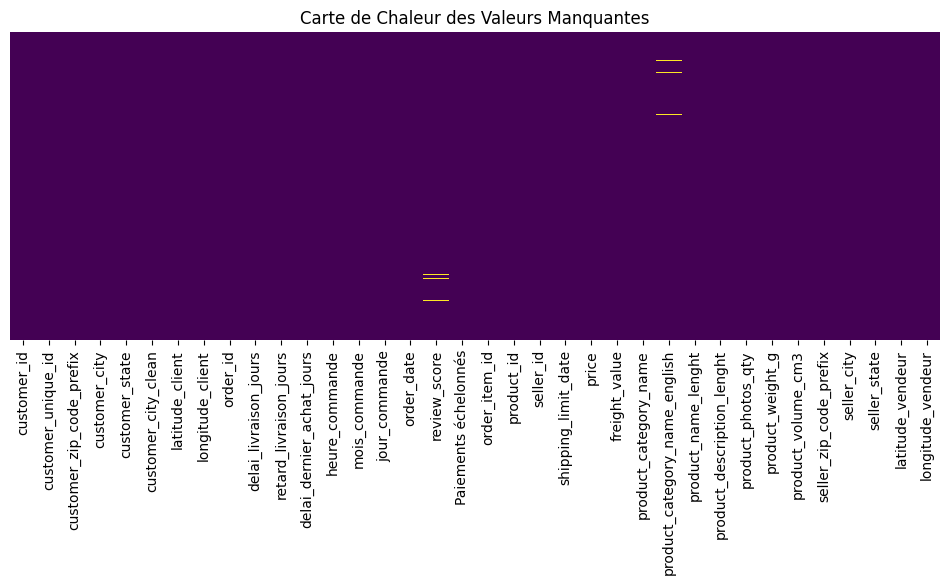

In [422]:
# Identification des valeurs manquantes
missing_values = data.isnull().sum()
missing_percentage = (missing_values / len(data)) * 100

# Création d'un DataFrame pour les valeurs manquantes
missing_data = pd.DataFrame({
    'Valeurs Manquantes': missing_values,
    'Pourcentage': missing_percentage
}).sort_values(by='Valeurs Manquantes', ascending=False)

# Affichage du DataFrame des valeurs manquantes
print(missing_data)

# Visualisation des valeurs manquantes avec une carte de chaleur
plt.figure(figsize=(12, 4))
sns.heatmap(data.isnull(), cbar=False, cmap='viridis', yticklabels=False)
plt.title('Carte de Chaleur des Valeurs Manquantes')
plt.show()

* La colonne product_category_name_english contient 1,41% de valeurs manquantes. Cela peut être dû à des catégories non traduites.
* La colonne review_score a 0,75% de valeurs manquantes, peut-être parce que certains clients n'ont pas laissé d'avis.
* Les colonnes des coordonnées géographiques des vendeurs et clients comptent également des valeurs manquantes.
* Paiements échelonnés a seulement 3 valeurs manquantes, donc ces lignes peuvent être supprimées sans grande perte.

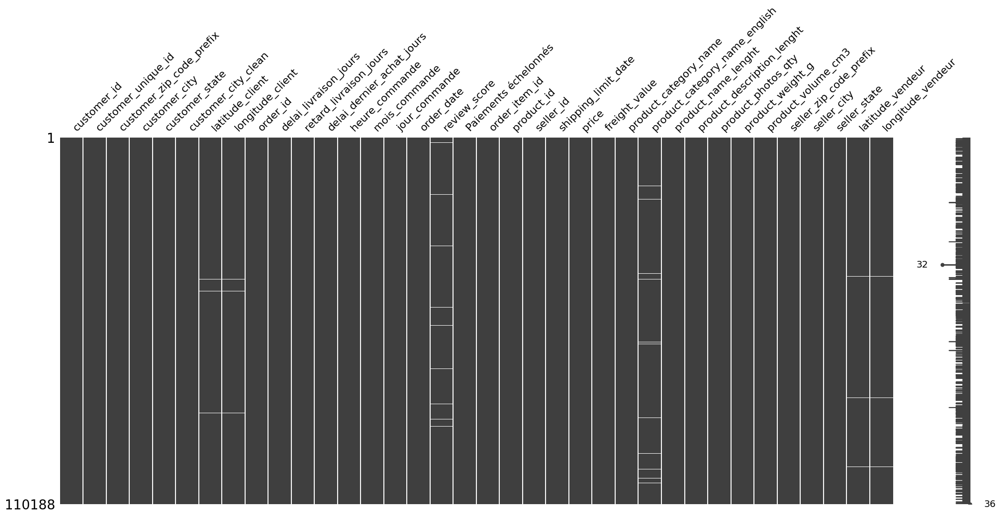

In [424]:
# Visualisation de la complétude des données :
%matplotlib inline
msno.matrix(data)
plt.show()

* ### Suppression des lignes avec des valeurs manquantes

In [426]:
# Suppression de toutes les lignes du DataFrame qui contiennent au moins une valeur manquante
#data = data[~data.isnull().any(axis=1)]

Cette approche est radicale : au lieu d’imputer les valeurs manquantes, on supprime les lignes entières, vu qu'on a assez de données.

*  ### OU / Remplissage des valeurs manquantes

In [429]:
# Remplacement des NAN des catégories par "unknown" pour éviter les valeurs manquantes.
data['product_category_name_english'] = data['product_category_name_english'].fillna('unknown')

# Pour les commandes sans avis client, on attribue un score neutre de 3 (valeur médiane de la notation)
data['review_score'] = data['review_score'].fillna(3)

# On applique fillna(method='ffill'), ce qui remplace une valeur NaN par la dernière valeur connue au-dessus (Forward Fill).
# Cela est utile si les coordonnées des clients sont ordonnées et si les valeurs précédentes sont cohérentes
data[['latitude_client', 'longitude_client']] = data[['latitude_client', 'longitude_client']].ffill()

# On applique le Forward Fill (ffill) pour propager les valeurs connues vers les lignes où elles sont manquantes.
data[['latitude_vendeur', 'longitude_vendeur']] = data[['latitude_vendeur', 'longitude_vendeur']].ffill()

# 3 commandes ont un NaN dans le nombre d’échéances de paiement.
# On suppose que ces paiements ont été faits en une seule fois (1 échéance)
data['Paiements échelonnés'] = data['Paiements échelonnés'].fillna(1)

# Affichage du nombre de valeurs manquantes restantes
print(data.isnull().sum())

customer_id                      0
customer_unique_id               0
customer_zip_code_prefix         0
customer_city                    0
customer_state                   0
customer_city_clean              0
latitude_client                  0
longitude_client                 0
order_id                         0
delai_livraison_jours            0
retard_livraison_jours           0
delai_dernier_achat_jours        0
heure_commande                   0
mois_commande                    0
jour_commande                    0
order_date                       0
review_score                     0
Paiements échelonnés             0
order_item_id                    0
product_id                       0
seller_id                        0
shipping_limit_date              0
price                            0
freight_value                    0
product_category_name            0
product_category_name_english    0
product_name_lenght              0
product_description_lenght       0
product_photos_qty  

In [430]:
data.shape

(110188, 36)

### **VARIABLE RFM 2 : FREQUENCE (Frequency)**
La fréquence mesure combien de fois un client a effectué un achat pendant une période donnée. Cela permet de savoir si le client est un acheteur récurrent ou un acheteur occasionnel.

* ### Ajout du nombre de commandes par client

Nous allons compter le nombre de commandes passées par chaque client unique.
Puis, fusionner cette information avec data pour ajouter une colonne Nombre_de_commande.

Cela nous permettra de savoir si le client est un acheteur récurrent ou un acheteur occasionnel.

Une fréquence élevée indique un client fidèle.

In [433]:
# Calcul du nombre de commandes par client unique et création d'un DataFrame avec ces informations
commandes_par_client = data['customer_unique_id'].value_counts().to_frame().reset_index()
# Renommage des colonnes pour une meilleure clarté
commandes_par_client.columns = ['customer_unique_id', 'Nombre_de_commande']

# Fusion du DataFrame original avec le DataFrame des commandes par client unique pour ajouter la colonne Nombre_de_commande
data = pd.merge(data, commandes_par_client, on='customer_unique_id', how='inner')

# Affichage des premières lignes du DataFrame mis à jour pour vérifier le résultat
data.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,customer_city_clean,latitude_client,longitude_client,order_id,delai_livraison_jours,retard_livraison_jours,delai_dernier_achat_jours,heure_commande,mois_commande,jour_commande,order_date,review_score,Paiements échelonnés,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_volume_cm3,seller_zip_code_prefix,seller_city,seller_state,latitude_vendeur,longitude_vendeur,Nombre_de_commande
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,São Paulo,franca,-20.499273,-47.396658,00e7ee1b050b8499577073aeb2a297a1,8,0,650,15,5,2,2017-05-16,4.0,2.0,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,office_furniture,41.0,1141.0,1.0,8683.0,107136.0,8577,itaquaquecetuba,São Paulo,-23.486138,-46.367107,1
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,São Paulo,saobernardodocampo,-23.728396,-46.542250,29150127e6685892b6eab3eec79f59c7,16,0,408,20,1,5,2018-01-12,5.0,8.0,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,housewares,43.0,1002.0,3.0,10150.0,53400.0,88303,itajai,Santa Catarina,-26.912506,-48.674090,1
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,São Paulo,saopaulo,-23.531309,-46.656690,b2059ed67ce144a36e2aa97d2c9e9ad2,26,1,282,16,5,6,2018-05-19,5.0,7.0,1,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,office_furniture,55.0,955.0,1.0,8267.0,45968.0,8577,itaquaquecetuba,São Paulo,-23.486138,-46.367107,1
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,São Paulo,mogidascruzes,-23.500670,-46.186348,951670f92359f4fe4a63112aa7306eba,14,0,349,16,3,2,2018-03-13,5.0,1.0,1,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,office_furniture,48.0,1066.0,1.0,12160.0,79968.0,8577,itaquaquecetuba,São Paulo,-23.486138,-46.367107,1
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,São Paulo,campinas,-22.975708,-47.143140,6b7d50bd145f6fc7f33cebabd7e49d0f,11,0,211,9,7,7,2018-07-29,5.0,8.0,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,casa_conforto,home_confort,61.0,407.0,1.0,5200.0,23625.0,14940,ibitinga,São Paulo,-21.757225,-48.829541,1


* ### Analyse du comportement des clients (Filtrage des acheteurs ayant effectué plusieurs commandes)

In [435]:
# Filtrage des commandes pour obtenir celles dont le nombre de commandes est différent de 1
acheteurs_plusieurs_commandes = commandes_par_client[commandes_par_client['Nombre_de_commande'] != 1]

# Calcul du pourcentage d'acheteurs ayant commandé plusieurs fois
pourcentage = round((len(acheteurs_plusieurs_commandes) / len(commandes_par_client)) * 100, 2)

# Affichage du résultat
print(f"{pourcentage} % des acheteurs ont passé plusieurs commandes sur le site internet.")

12.44 % des acheteurs ont passé plusieurs commandes sur le site internet.


Nous avons sélectionné les clients ayant effectué plusieurs commandes. Cela permet de se concentrer sur les clients récurrents et de calculer des métriques spécifiques sur eux.

Résultat : 12,44 % des clients ont commandé au moins deux fois.
La majorité des clients semblent n'acheter qu'une seule fois.

* ### Visualisation des distributions : 
    * des délais de livraison
    * des scores d’avis
    * des relation entre prix et score de review

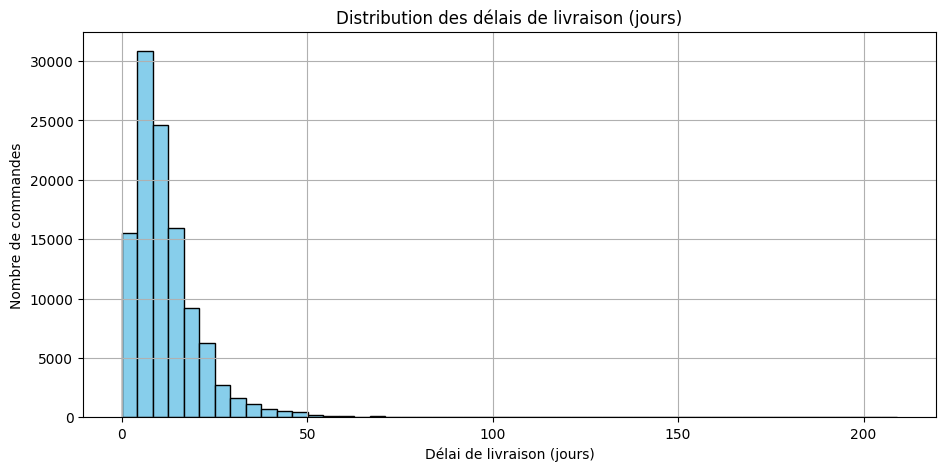

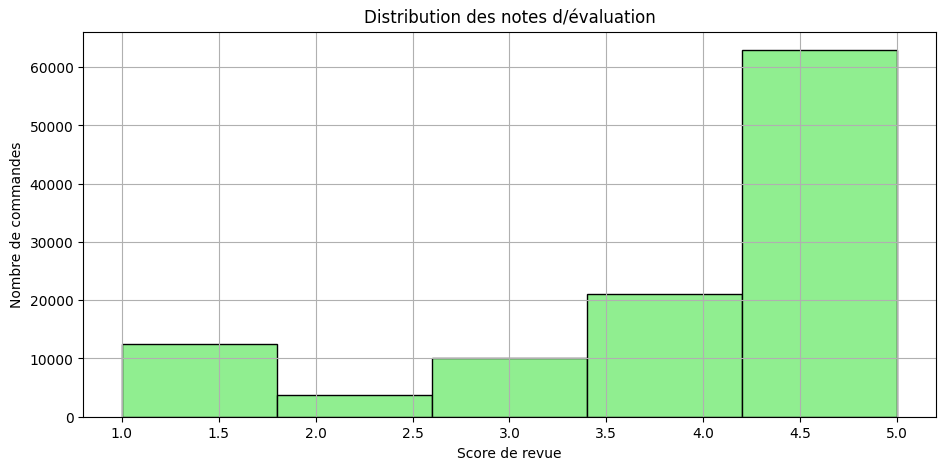

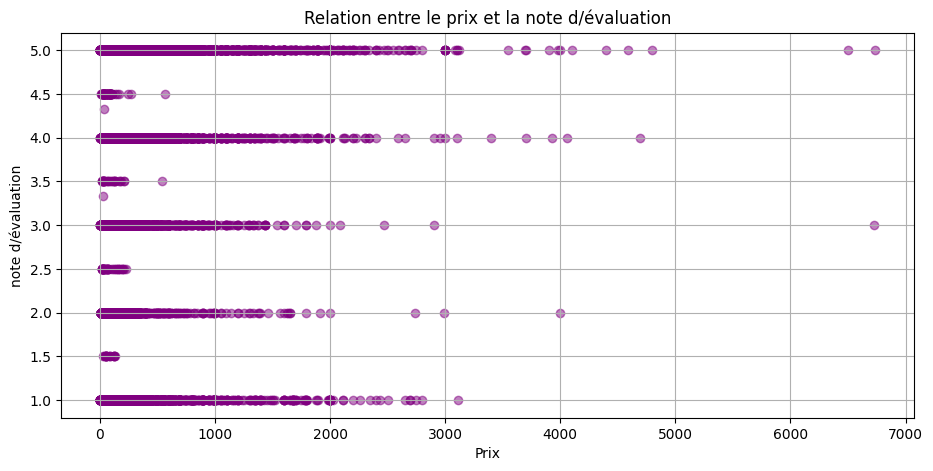

In [438]:
# Distribution des délais de livraison (permet d'observer la répartition des délais de livraison)
plt.figure(figsize=(11, 5))
plt.hist(data['delai_livraison_jours'], bins=50, color='skyblue', edgecolor='black')
plt.title('Distribution des délais de livraison (jours)')
plt.xlabel('Délai de livraison (jours)')
plt.ylabel('Nombre de commandes')
plt.grid(True)
plt.show()

# Distribution des notes d'évaluation (Visualisation des notes laissées par les clients)
plt.figure(figsize=(11, 5))
plt.hist(data['review_score'], bins=5, color='lightgreen', edgecolor='black')
plt.title('Distribution des notes d/évaluation')
plt.xlabel('Score de revue')
plt.ylabel('Nombre de commandes')
plt.grid(True)
plt.show()

# Relation entre le prix et la note d'évaluation (pour voir si le prix influence la note client)
plt.figure(figsize=(11, 5))
plt.scatter(data['price'], data['review_score'], alpha=0.5, c='purple')
plt.title('Relation entre le prix et la note d/évaluation')
plt.xlabel('Prix')
plt.ylabel('note d/évaluation')
plt.grid(True)
plt.show()

* La majorité des commandes ont des délais de livraison entre 0 et 20 jours, avec quelques valeurs extrêmes allant jusqu'à 209 jours. observe une longue traîne, indiquant les retards de livraison.

* Les notes d'évaluation sont majoritairement élevées, avec une concentration notable autour des notes de 4 et 5.

* La relation entre le prix et la note d'évaluation semble aléatoire, sans tendance claire visible. Cela indique que le prix du produit n'affecte pas significativement la note d'évaluation.

### **VARIABLE RFM 3 : MONTANT (Monetary)**
Le montant mesure combien d'argent un client a dépensé pendant une période donnée. C'est un indicateur clé de la valeur économique d'un client.

* ### Ajout d'une colonne pour le coût total avec les frais de livraison

Nous allons ajouter une nouvelle colonne CoutTotalAvecFraisDeLivraison qui représentera  Le montant total dépensé par un client, incluant les frais de livraison. Cette variable donne une idée de la valeur globale d'un client.

In [442]:
# Ajout d'une colonne qui représente le prix total d'une commande, en incluant les frais de livraison, en utilisant apply avec une fonction lambda
data['CoutTotalAvecFraisDeLivraison'] = data.apply(lambda row: row['price'] + row['freight_value'], axis=1)

### **Résumé de nos variables RFM :**
* Récence : delai_dernier_achat_jours
* Fréquence : Nombre_de_commande
* Montant : CoutTotalAvecFraisDeLivraison

Ces trois variables, combinées, permettent de créer un profil détaillé du comportement de chaque client, utile pour des stratégies de segmentation, des campagnes ciblées, ou des prédictions de fidélité.

* ### Calcul de la distance entre chaque client et son vendeur (distance haversine)
La fonction haversine permet de calculer la distance en kilomètres entre deux points donnés par leurs coordonnées géographiques (latitude et longitude) en tenant compte de la courbure de la Terre.

Le calcul de la distance Haversine peut être utile dans ce projet de segmentation client pour :
* Optimiser la segmentation géographique : on peut regrouper les clients en clusters basés sur leur proximité avec les vendeurs ou les points de livraison.
* Étudier l’impact des distances sur les délais de livraison et la satisfaction client : voir si les commandes plus éloignées ont plus de retards ou des avis négatifs.

* #### **La formule Haversine**

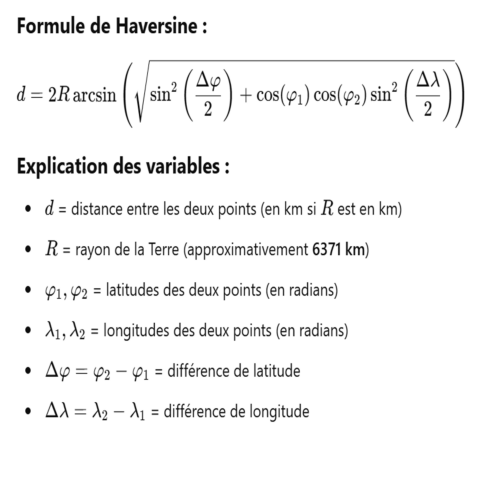

In [446]:
from IPython.display import display
from PIL import Image

# Charger et afficher l'image
image = Image.open(r"C:\Users\matym\Pictures\Screenshots\image.png")
# Redimensionner l'image (ajuster les dimensions selon vos besoins)
image_resized = image.resize((1000, 1000))

# Ajuster la taille de la figure
plt.figure(figsize=(12, 6))

# Afficher l'image
plt.imshow(image_resized)
plt.axis('off')  # Pour cacher les axes
plt.show()

* #### **Calcul**

In [448]:
# Fonction pour calculer la distance haversine
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Rayon de la Terre en km
    phi1 = np.radians(lat1)
    phi2 = np.radians(lat2)
    delta_phi = np.radians(lat2 - lat1)
    delta_lambda = np.radians(lon2 - lon1)
    
    a = np.sin(delta_phi / 2.0) ** 2 + \
        np.cos(phi1) * np.cos(phi2) * \
        np.sin(delta_lambda / 2.0) ** 2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    
    return R * c  # Distance en kilomètres

# Calcul de la distance entre chaque client et son vendeur
data['distance_km_VendeurClient'] = data.apply(
    lambda row: haversine(row['latitude_vendeur'], row['longitude_vendeur'], row['latitude_client'], row['longitude_client']),
    axis=1
)

# Affichage des premières lignes pour vérifier
print(data[['customer_unique_id', 'seller_id', 'latitude_client', 'longitude_client', 'latitude_vendeur', 'longitude_vendeur', 'distance_km_VendeurClient']].head(100))

                  customer_unique_id                         seller_id  \
0   861eff4711a542e4b93843c6dd7febb0  7c67e1448b00f6e969d365cea6b010ab   
1   290c77bc529b7ac935b93aa66c333dc3  b8bc237ba3788b23da09c0f1f3a3288c   
2   060e732b5b29e8181a18229c7b0b2b5e  7c67e1448b00f6e969d365cea6b010ab   
3   259dac757896d24d7702b9acbbff3f3c  7c67e1448b00f6e969d365cea6b010ab   
4   345ecd01c38d18a9036ed96c73b8d066  4a3ca9315b744ce9f8e9374361493884   
5   4c93744516667ad3b8f1fb645a3116a4  8f2ce03f928b567e3d56181ae20ae952   
6   addec96d2e059c80c30fe6871d30d177  9f505651f4a6abe901a56cdc21508025   
7   57b2a98a409812fe9618067b6b8ebe4f  2a7dc43cecabf23403078e2188437d1d   
8   1175e95fb47ddff9de6b2b06188f7e0d  95e03ca3d4146e4011985981aeb959b9   
9   9afe194fb833f79e300e37e580171f22  0241d4d5d36f10f80c644447315af0bd   
10  2a7745e1ed516b289ed9b29c7d0539a5  b6e1504972665f739dec4facb9943775   
11  2a46fb94aef5cbeeb850418118cee090  ec8879960bd2221d5c32f8e12f7da711   
12  918dc87cd72cd9f6ed4bd442ed785235  

In [449]:
data.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'customer_city_clean',
       'latitude_client', 'longitude_client', 'order_id',
       'delai_livraison_jours', 'retard_livraison_jours',
       'delai_dernier_achat_jours', 'heure_commande', 'mois_commande',
       'jour_commande', 'order_date', 'review_score', 'Paiements échelonnés',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'product_category_name',
       'product_category_name_english', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_volume_cm3', 'seller_zip_code_prefix', 'seller_city',
       'seller_state', 'latitude_vendeur', 'longitude_vendeur',
       'Nombre_de_commande', 'CoutTotalAvecFraisDeLivraison',
       'distance_km_VendeurClient'],
      dtype='object')

* ### Suppression de colonnes inutiles

In [451]:
# Suppression des Variables de geolocalisation :
data.drop(columns=['customer_state', 'seller_state', 'seller_zip_code_prefix',
                   'customer_city', 'seller_city', 'customer_zip_code_prefix', 
                   'customer_city_clean', 'latitude_client', 'longitude_client', 
                   'latitude_vendeur', 'longitude_vendeur'], inplace=True)

# Suppression des colonnes liées aux identifiants des vendeurs, clients, commandes et produits sauf (customer_unique_id)
data.drop(columns=['seller_id', 'customer_id', 'order_id', 'product_id'], inplace=True)

* Suppression des colonnes de géolocalisation : inutiles après géolocalisation.
* Suppression des identifiants (seller_id, customer_id, order_id, product_id) : pas nécessaires pour l'analyse, sauf customer_unique_id qui est gardé.

* ### Analyse des ventes globales par catégorie de produit

In [454]:
# Agréger les données par catégorie de produit
categories = data.groupby('product_category_name').agg({
    'CoutTotalAvecFraisDeLivraison': 'sum', 
    'delai_livraison_jours': 'count'
}).rename(columns={'delai_livraison_jours': 'Quantite'}).sort_values('CoutTotalAvecFraisDeLivraison', ascending=False)

* On a regroupé les produits par catégorie.

* On a calculé :
    * Le chiffre d'affaires total (CoutTotalAvecFraisDeLivraison) par catégorie de produit.
    * La quantité vendue (delai_livraison_jours est ici utilisé pour compter les lignes, donc c'est un proxy du nombre de ventes).
    * On a trié les catégories en fonction du chiffre d'affaires décroissant.
 
Nous pouvons voir quelles catégories de produits sont les plus populaires en termes de ventes totales et de volume.

* ### Visualisation des Top et Flop 10 catégories

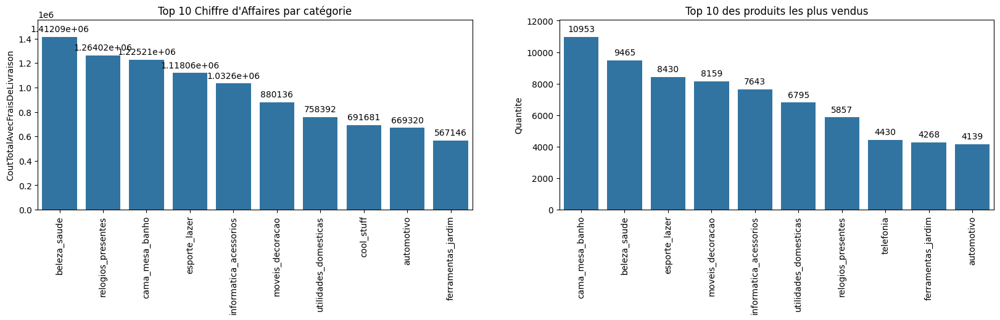

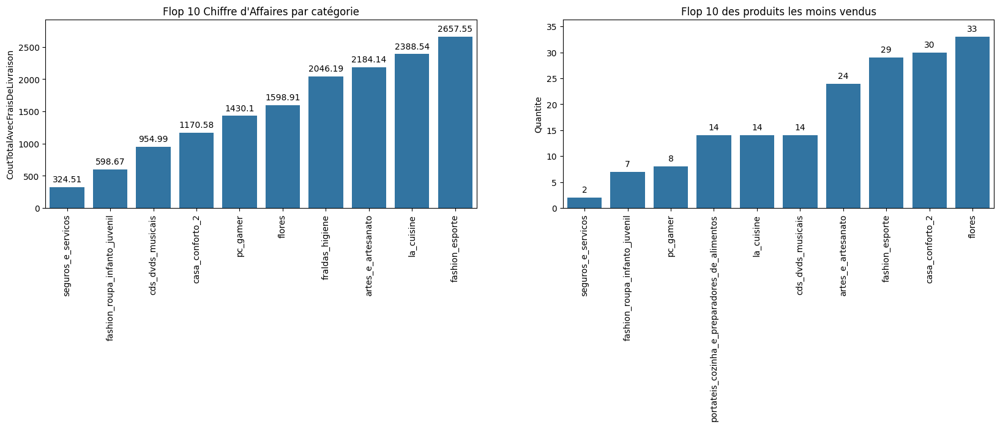

In [457]:
# Représentation graphique : Top 10 des catégories par chiffre d'affaires
plt.subplots(1, 2, figsize=(20, 4))

# Graphique du Top 10 des catégories par chiffre d'affaires
plt.subplot(121)
ax1 = sns.barplot(x=categories.head(10).index, y=categories['CoutTotalAvecFraisDeLivraison'].head(10))
ax1.bar_label(ax1.containers[0], padding=4)
plt.title('Top 10 Chiffre d\'Affaires par catégorie')
plt.xticks(rotation=90)
plt.xlabel('')
ax1.margins(y=0.1)

# Graphique du Top 10 des produits les plus vendus
plt.subplot(122)
categories = categories.sort_values('Quantite', ascending=False)
ax2 = sns.barplot(x=categories.head(10).index, y=categories['Quantite'].head(10))
ax2.bar_label(ax2.containers[0], padding=4)
plt.title('Top 10 des produits les plus vendus')
plt.xticks(rotation=90)
plt.xlabel('')
ax2.margins(y=0.1)

plt.show()

# Représentation graphique : Flop 10 des catégories par chiffre d'affaires
plt.subplots(1, 2, figsize=(20, 4))

# Graphique du Flop 10 des catégories par chiffre d'affaires
plt.subplot(121)
categories = categories.sort_values('CoutTotalAvecFraisDeLivraison', ascending=True)
ax3 = sns.barplot(x=categories.head(10).index, y=categories['CoutTotalAvecFraisDeLivraison'].head(10))
ax3.bar_label(ax3.containers[0], padding=4)
plt.title('Flop 10 Chiffre d\'Affaires par catégorie')
plt.xticks(rotation=90)
plt.xlabel('')
ax3.margins(y=0.1)

# Graphique du Top 10 des produits les moins vendus
plt.subplot(122)
categories = categories.sort_values('Quantite', ascending=True)
ax4 = sns.barplot(x=categories.head(10).index, y=categories['Quantite'].head(10))
ax4.bar_label(ax4.containers[0], padding=4)
plt.title('Flop 10 des produits les moins vendus')
plt.xticks(rotation=90)
plt.xlabel('')
ax4.margins(y=0.1)

plt.show()

* Deux graphiques à chaque fois :
* Top 10 des catégories les plus rentables et les plus vendues avec :
    * À gauche : Les catégories avec le plus haut chiffre d’affaires.
    * À droite : Les catégories avec le plus grand nombre de ventes.

* Flop 10 des catégories les moins rentables et les moins vendues avec :
    * Le plus faible chiffre d'affaires.
    * Le plus faible nombre de ventes.

* ### Normalisation des longueurs de texte et du nombre de photos

* On normalise trois variables liées à la présentation du produit :
    * product_name_lenght (longueur du nom du produit),
    * product_description_lenght (longueur de la description),
    * product_photos_qty (nombre de photos du produit).
* On utilise MinMaxScaler pour mettre ces variables entre 0 et 1.
* Ensuite, on calcule un score de présentation du produit :
    * Il additionne le nombre de photos et la description,
    * Il divise 1 par la longueur du nom (pour pénaliser les noms trop courts).
* Enfin, on supprime les colonnes originales.

In [461]:
from sklearn.preprocessing import MinMaxScaler

# Définition des colonnes à normaliser
cols_to_scale = ['product_name_lenght', 'product_description_lenght', 'product_photos_qty']

# Initialisation du scaler
scaler = MinMaxScaler()
data[cols_to_scale] = scaler.fit_transform(data[cols_to_scale])

# Calcul du score de présentation du produit
data['ScorePresentationProduit'] = round(data['product_photos_qty'] + data['product_description_lenght'] + 1 / data['product_name_lenght'], 2)

# Suppression des colonnes originales utilisées pour le calcul
data.drop(columns=cols_to_scale, inplace=True)

**Le Score de Présentation** est une mesure qui évalue l'attrait ou la visibilité d'un produit, généralement en fonction de critères tels que son design, son packaging, ou son positionnement par rapport à d'autres produits. Il peut inclure des éléments subjectifs comme l'apparence et des éléments objectifs comme la popularité ou les évaluations des clients.

* Utilité :
    * Optimisation du marketing : Un produit avec un score élevé en présentation peut être mis en avant dans les campagnes marketing, car il attire davantage l'attention des consommateurs.
    * Meilleur placement en rayon : Les produits avec un score élevé pourraient être placés dans des zones à forte visibilité ou être proposés en priorité sur les sites de commerce en ligne.
    * Amélioration des ventes : Des produits bien présentés et bien perçus par les clients peuvent générer davantage de ventes, car une présentation attractive influence souvent la décision d'achat.
    * Gestion de l'inventaire : Ce score peut aider à gérer l'inventaire de manière plus ciblée, en mettant en avant des produits qui ont un fort potentiel de vente.

* ### Normalisation des variables d'encombrement
  On normalise le volume et le poids des produits.
  
  On calcule un Score d'encombrement (somme des valeurs normalisées).
  
  On supprime ensuite les colonnes originales.

In [464]:
# Normalisation des variables de volume et de poids
scaler = MinMaxScaler()

# Sélection des colonnes à normaliser
cols_to_scale = ['product_volume_cm3', 'product_weight_g']

# Ajustement et transformation des données
scaler.fit(data[cols_to_scale])
scaled_values = scaler.transform(data[cols_to_scale])

# Création d'un DataFrame pour les valeurs normalisées
normalized_data = pd.DataFrame(scaled_values, columns=cols_to_scale)

# Calcul du score d'encombrement en additionnant le volume et le poids normalisés
normalized_data['ScoreEncombrement'] = normalized_data['product_volume_cm3'] + normalized_data['product_weight_g']

# Fusion du score d'encombrement avec les données initiales
data = data.join(normalized_data['ScoreEncombrement'])

# Suppression des colonnes originales de volume et de poids
data.drop(columns=['product_volume_cm3', 'product_weight_g'], inplace=True)

# Suppression la colonne ScoreEncombrement si elle n'est plus nécessaire dans Data
# del merged_data['ScoreEncombrement']

In [465]:
data

,customer_unique_id,delai_livraison_jours,retard_livraison_jours,delai_dernier_achat_jours,heure_commande,mois_commande,jour_commande,order_date,review_score,Paiements échelonnés,order_item_id,shipping_limit_date,price,freight_value,product_category_name,product_category_name_english,Nombre_de_commande,CoutTotalAvecFraisDeLivraison,distance_km_VendeurClient,ScorePresentationProduit,ScoreEncombrement
0,861eff4711a542e4b93843c6dd7febb0,8,0,650,15,5,2,2017-05-16,4.0,2.0,1,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,office_furniture,1,146.87,348.669640,2.26,0.576084
1,290c77bc529b7ac935b93aa66c333dc3,16,0,408,20,1,5,2018-01-12,5.0,8.0,1,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,housewares,1,335.48,413.823504,2.22,0.430859
2,060e732b5b29e8181a18229c7b0b2b5e,26,1,282,16,5,6,2018-05-19,5.0,7.0,1,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,office_furniture,1,157.73,29.951598,1.66,0.359172
3,259dac757896d24d7702b9acbbff3f3c,14,0,349,16,3,2,2018-03-13,5.0,1.0,1,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,office_furniture,1,173.30,18.504046,1.92,0.570328
4,345ecd01c38d18a9036ed96c73b8d066,11,0,211,9,7,7,2018-07-29,5.0,8.0,1,2018-07-31 10:10:09,230.00,22.25,casa_conforto,home_confort,1,252.25,220.061313,1.37,0.207826
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110183,1a29b476fee25c95fbafc67c5ac95cf8,6,0,324,15,4,6,2018-04-07,4.0,6.0,1,2018-04-12 16:08:45,74.90,13.88,livros_interesse_geral,books_general_interest,1,88.78,357.876152,1.72,0.052101
110184,d52a67c98be1cf6a5c84435bd38d095d,7,0,327,8,4,3,2018-04-04,5.0,3.0,1,2018-04-10 08:35:12,114.90,14.16,esporte_lazer,sports_leisure,1,129.06,251.153081,1.84,0.073930
110185,e9f50caf99f032f0bf3c55141f019d99,30,7,322,20,4,7,2018-04-08,1.0,5.0,1,2018-04-12 20:30:03,37.00,19.04,beleza_saude,health_beauty,1,56.04,2367.081714,1.43,0.051307
110186,73c2643a0a458b49f58cea58833b192e,12,0,478,21,11,5,2017-11-03,5.0,2.0,1,2017-11-09 21:15:51,689.00,22.07,relogios_presentes,watches_gifts,1,711.07,999.039829,1.43,0.028628


**Le score d'encombrement** est une mesure qui combine le poids et le volume d'un produit pour obtenir une évaluation de l'encombrement qu'il représente, en particulier dans un contexte logistique et de gestion des stocks. L'idée est de quantifier l'impact qu'un produit aura sur l'espace de stockage et sur les coûts de transport en fonction de sa taille et de son poids.

Nous avons créé un score d'encombrement en combinant deux variables normalisées :
* Volume du produit (product_volume_cm3) : Mesure du volume occupé par un produit, généralement exprimé en centimètres cubes.
* Poids du produit (product_weight_g) : Mesure du poids du produit, généralement exprimée en grammes.

En normalisant ces deux variables (pour les mettre sur une échelle comparable) et en les additionnant, Nous obtenons un score qui reflète l'impact logistique d'un produit. 

* Utilité :
    * Prioriser l'espace de stockage.
    * Optimiser la gestion des stocks et la logistique.
    * Calculer les coûts de transport, car les produits plus volumineux et plus lourds coûtent généralement plus cher à expédier.

Ainsi, un score d'encombrement plus élevé signifie que le produit occupe plus d'espace et/ou est plus lourd, ce qui pourrait entraîner des coûts plus élevés dans le cadre de la gestion des stocks et du transport.

* ### Agrégation des données par client unique
* On regroupe par client unique (customer_unique_id) et on agrège plusieurs variables :
    * Moyenne des délais et retards de livraison.
    * Dernier achat (minimum des jours écoulés).
    * Moyenne des paiements, prix, frais de livraison et notes d'avis.
    * Nombre maximal de commandes par client.
    * Moyenne du coût total avec livraison.

In [468]:
# Agrégation des données par client unique
Data_Final = data.groupby('customer_unique_id').agg({
    'delai_livraison_jours': 'mean',             # Délai moyen de livraison
    'retard_livraison_jours': 'mean',            # Retard moyen de livraison
    'delai_dernier_achat_jours': 'min',          # Délai minimum depuis le dernier achat
    'Paiements échelonnés': 'mean',              # Nombre moyen de paiements
    'price': 'mean',                             # Prix moyen des produits
    'freight_value': 'mean',                     # Valeur moyenne des frais de port
    'review_score': 'mean',                      # Note moyenne des avis
    'Nombre_de_commande': 'max',                 # Nombre maximum de commandes
    'distance_km_VendeurClient': 'mean',         # Distance moyenne en kilomètres entre chaque client et son vendeur
    'CoutTotalAvecFraisDeLivraison': 'mean'      # Coût total moyen avec frais de livraison
})

# Réinitialisation des index pour obtenir un DataFrame ordinaire
Data_Final.reset_index(inplace=True)

In [469]:
# Vérification du nombre de clients après agrégation
print(f"Nombre de clients uniques dans le DataFrame final : {Data_Final['customer_unique_id'].nunique()}")

Nombre de clients uniques dans le DataFrame final : 93349


* ### Trouver la catégorie la plus achetée par client

In [471]:
# Compter le nombre d'articles achetés par client et par catégorie
Top_Product_Category = data.groupby(['customer_unique_id', 'product_category_name']) \
    .agg({'order_item_id': 'count'}) \
    .reset_index()

# Identification de la catégorie la plus achetée pour chaque client
Top_Product_Category = Top_Product_Category.loc[
    Top_Product_Category.groupby('customer_unique_id')['order_item_id'].idxmax(),
    ['customer_unique_id', 'product_category_name']
].rename(columns={'product_category_name': 'Top_Product_Category'})

* ### Et Fusionner avec Data_Final

In [473]:
Data_Final = Data_Final.merge(Top_Product_Category, on='customer_unique_id', how='left')

In [474]:
# Vérification du nombre de clients après agrégation
print(f"Nombre de clients uniques dans le DataFrame final : {Data_Final['customer_unique_id'].nunique()}")

Nombre de clients uniques dans le DataFrame final : 93349


In [475]:
Data_Final

,customer_unique_id,delai_livraison_jours,retard_livraison_jours,delai_dernier_achat_jours,Paiements échelonnés,price,freight_value,review_score,Nombre_de_commande,distance_km_VendeurClient,CoutTotalAvecFraisDeLivraison,Top_Product_Category
0,0000366f3b9a7992bf8c76cfdf3221e2,6.0,0.0,291,8.0,129.90,12.00,5.0,1,110.528468,141.90,cama_mesa_banho
1,0000b849f77a49e4a4ce2b2a4ca5be3f,3.0,0.0,294,1.0,18.90,8.29,4.0,1,22.233428,27.19,beleza_saude
2,0000f46a3911fa3c0805444483337064,25.0,0.0,716,8.0,69.00,17.22,3.0,1,517.016952,86.22,papelaria
3,0000f6ccb0745a6a4b88665a16c9f078,20.0,0.0,500,4.0,25.99,17.63,4.0,1,2481.241232,43.62,telefonia
4,0004aac84e0df4da2b147fca70cf8255,13.0,0.0,468,6.0,180.00,16.89,5.0,1,154.518198,196.89,telefonia
...,...,...,...,...,...,...,...,...,...,...,...,...
93344,fffcf5a5ff07b0908bd4e2dbc735a684,27.0,0.0,626,10.0,785.00,248.71,5.0,2,1996.464618,1033.71,beleza_saude
93345,fffea47cd6d3cc0a88bd621562a9d061,30.0,0.0,441,1.0,64.89,19.69,4.0,1,1527.149565,84.58,bebes
93346,ffff371b4d645b6ecea244b27531430a,14.0,0.0,748,1.0,89.90,22.56,5.0,1,1526.114883,112.46,automotivo
93347,ffff5962728ec6157033ef9805bacc48,11.0,0.0,299,5.0,115.00,18.69,5.0,1,637.816306,133.69,relogios_presentes


* ### Transformation des données

**1- Renommage des colonnes (on donne des noms plus explicites aux colonnes)**

In [478]:
# Renommage des colonnes du DataFrame final
nouveaux_noms_colonnes = [
    'customer_unique_id', 'Delais_livraison_jours', 'Retard_livraison_jours',
    'Delais_dernier_achat_jours', 'Paiements échelonnés', 'PrixCommandeMoyen',
    'FraisDeLivraisonMoyen', 'ScoreCommentaireMoyen', 'Nombre_de_commande', 
    'distance_km_VendeurClient', 'CoutTotalAvecFraisDeLivraison', 'Top_Product_Category'
]

Data_Final.columns = nouveaux_noms_colonnes

In [479]:
Data_Final

,customer_unique_id,Delais_livraison_jours,Retard_livraison_jours,Delais_dernier_achat_jours,Paiements échelonnés,PrixCommandeMoyen,FraisDeLivraisonMoyen,ScoreCommentaireMoyen,Nombre_de_commande,distance_km_VendeurClient,CoutTotalAvecFraisDeLivraison,Top_Product_Category
0,0000366f3b9a7992bf8c76cfdf3221e2,6.0,0.0,291,8.0,129.90,12.00,5.0,1,110.528468,141.90,cama_mesa_banho
1,0000b849f77a49e4a4ce2b2a4ca5be3f,3.0,0.0,294,1.0,18.90,8.29,4.0,1,22.233428,27.19,beleza_saude
2,0000f46a3911fa3c0805444483337064,25.0,0.0,716,8.0,69.00,17.22,3.0,1,517.016952,86.22,papelaria
3,0000f6ccb0745a6a4b88665a16c9f078,20.0,0.0,500,4.0,25.99,17.63,4.0,1,2481.241232,43.62,telefonia
4,0004aac84e0df4da2b147fca70cf8255,13.0,0.0,468,6.0,180.00,16.89,5.0,1,154.518198,196.89,telefonia
...,...,...,...,...,...,...,...,...,...,...,...,...
93344,fffcf5a5ff07b0908bd4e2dbc735a684,27.0,0.0,626,10.0,785.00,248.71,5.0,2,1996.464618,1033.71,beleza_saude
93345,fffea47cd6d3cc0a88bd621562a9d061,30.0,0.0,441,1.0,64.89,19.69,4.0,1,1527.149565,84.58,bebes
93346,ffff371b4d645b6ecea244b27531430a,14.0,0.0,748,1.0,89.90,22.56,5.0,1,1526.114883,112.46,automotivo
93347,ffff5962728ec6157033ef9805bacc48,11.0,0.0,299,5.0,115.00,18.69,5.0,1,637.816306,133.69,relogios_presentes


**2- Conversion en entier (on force certaines colonnes en entier pour éviter des valeurs décimales inutiles)**

In [481]:
# Conversion des colonnes spécifiées en type entier
colonnes_a_convertir = ['Delais_livraison_jours', 'Retard_livraison_jours', 'Paiements échelonnés', 'ScoreCommentaireMoyen', 'distance_km_VendeurClient']
                                                                                                      
Data_Final[colonnes_a_convertir] = Data_Final[colonnes_a_convertir].astype(int)

**3- Analyse de la distribution des variables (On compare la distribution normale et la distribution log-transformée.
Permet de voir si une transformation log est nécessaire pour réduire l’asymétrie des données.)**

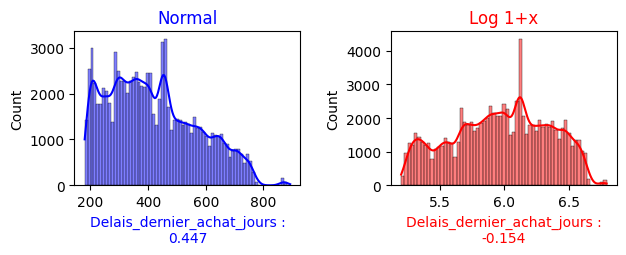

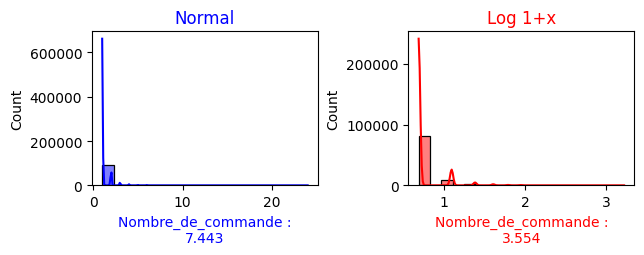

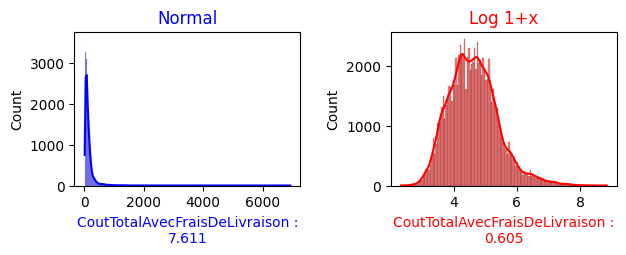

In [483]:
from scipy.stats import skew

# Liste des colonnes à analyser
colonnes_a_analyser = ['Delais_dernier_achat_jours', 'Nombre_de_commande', 'CoutTotalAvecFraisDeLivraison']

# Boucle sur chaque colonne pour créer les histogrammes
for colonne in colonnes_a_analyser:
    fig, ax = plt.subplots(1, 2, figsize=(7, 2))  # Taille ajustée pour une meilleure lisibilité
    
    # Histogramme de la distribution normale
    ax[0].set_title('Normal', color='blue')
    sns.histplot(Data_Final[colonne], color="blue", kde=True, ax=ax[0])
    skewness_normal = round(skew(Data_Final[colonne].to_list()), 3)
    ax[0].set_xlabel(f'{colonne} :\n{skewness_normal}', color='blue')
    
    # Histogramme de la distribution log-transformée
    ax[1].set_title('Log 1+x', color='red')
    sns.histplot(np.log1p(Data_Final[colonne]), color="red", kde=True, ax=ax[1])
    skewness_log = round(skew(np.log1p(Data_Final[colonne]).to_list()), 3)
    ax[1].set_xlabel(f'{colonne} :\n{skewness_log}', color='red')
    
    # Ajuster l'espace entre les sous-graphiques
    plt.subplots_adjust(wspace=0.4)
    plt.show()

**4- Transformation logarithmique aux variables spécifiées pour réduire l'effet des valeurs extrêmes et améliorer la distribution des données.**

In [485]:
# Transformation log des variables spécifiées
#variables_a_transformer = ['CoutTotalAvecFraisDeLivraison']

# Créer les nouvelles colonnes log-transformées
#for var in variables_a_transformer:
#    Data_Final[f'{var}(log)'] = np.log1p(Data_Final[var])

# 4. Dataframe final <a id="Dataframe-final"></a>

In [487]:
Data_Final.head(10)

,customer_unique_id,Delais_livraison_jours,Retard_livraison_jours,Delais_dernier_achat_jours,Paiements échelonnés,PrixCommandeMoyen,FraisDeLivraisonMoyen,ScoreCommentaireMoyen,Nombre_de_commande,distance_km_VendeurClient,CoutTotalAvecFraisDeLivraison,Top_Product_Category
0,0000366f3b9a7992bf8c76cfdf3221e2,6,0,291,8,129.90,12.00,5,1,110,141.90,cama_mesa_banho
1,0000b849f77a49e4a4ce2b2a4ca5be3f,3,0,294,1,18.90,8.29,4,1,22,27.19,beleza_saude
2,0000f46a3911fa3c0805444483337064,25,0,716,8,69.00,17.22,3,1,517,86.22,papelaria
3,0000f6ccb0745a6a4b88665a16c9f078,20,0,500,4,25.99,17.63,4,1,2481,43.62,telefonia
4,0004aac84e0df4da2b147fca70cf8255,13,0,468,6,180.00,16.89,5,1,154,196.89,telefonia
5,0004bd2a26a76fe21f786e4fbd80607f,1,0,326,8,154.00,12.98,4,1,27,166.98,ferramentas_jardim
6,00050ab1314c0e55a6ca13cf7181fecf,6,0,311,1,27.99,7.39,4,1,101,35.38,telefonia
7,00053a61a98854899e70ed204dd4bafe,16,0,362,3,191.00,18.59,1,2,503,209.59,esporte_lazer
8,0005e1862207bf6ccc02e4228effd9a0,4,0,722,3,135.00,15.12,4,1,246,150.12,fashion_bolsas_e_acessorios
9,0005ef4cd20d2893f0d9fbd94d3c0d97,53,31,350,4,104.90,24.86,1,1,2250,129.76,esporte_lazer


In [488]:
Data_Final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93349 entries, 0 to 93348
Data columns (total 12 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   customer_unique_id             93349 non-null  object 
 1   Delais_livraison_jours         93349 non-null  int32  
 2   Retard_livraison_jours         93349 non-null  int32  
 3   Delais_dernier_achat_jours     93349 non-null  int64  
 4   Paiements échelonnés           93349 non-null  int32  
 5   PrixCommandeMoyen              93349 non-null  float64
 6   FraisDeLivraisonMoyen          93349 non-null  float64
 7   ScoreCommentaireMoyen          93349 non-null  int32  
 8   Nombre_de_commande             93349 non-null  int64  
 9   distance_km_VendeurClient      93349 non-null  int32  
 10  CoutTotalAvecFraisDeLivraison  93349 non-null  float64
 11  Top_Product_Category           93349 non-null  object 
dtypes: float64(3), int32(5), int64(2), object(2)
m

In [489]:
Data_Final.describe()

,Delais_livraison_jours,Retard_livraison_jours,Delais_dernier_achat_jours,Paiements échelonnés,PrixCommandeMoyen,FraisDeLivraisonMoyen,ScoreCommentaireMoyen,Nombre_de_commande,distance_km_VendeurClient,CoutTotalAvecFraisDeLivraison
count,93349.000000,93349.000000,93349.000000,93349.000000,93349.000000,93349.000000,93349.000000,93349.000000,93349.000000,93349.000000
mean,12.093049,0.723211,417.247866,2.911665,125.826367,20.184698,4.141576,1.180388,601.216810,146.011065
std,9.551717,4.675877,152.589899,2.690880,190.541043,15.708911,1.281771,0.620885,592.349597,197.735464
min,0.000000,0.000000,180.000000,0.000000,0.850000,0.000000,1.000000,1.000000,0.000000,9.341429
25%,6.000000,0.000000,294.000000,1.000000,42.900000,13.370000,4.000000,1.000000,190.000000,57.750000
50%,10.000000,0.000000,398.000000,2.000000,79.000000,16.390000,5.000000,1.000000,435.000000,96.480000
75%,15.000000,0.000000,526.000000,4.000000,139.900000,21.190000,5.000000,1.000000,798.000000,162.770000
max,209.000000,188.000000,893.000000,24.000000,6735.000000,409.680000,5.000000,24.000000,3399.000000,6929.310000


In [490]:
Data_Final.to_csv("data.csv", index=False)

# _______________________________________________________

**Explication détaillée des colonnes présentes dans notre dataframe Data_Final**

1. customer_unique_id : identifiant unique pour chaque client dans notre dataset. Permet de lier toutes les commandes et informations relatives à un client spécifique.

2. Delais_livraison_jours : C'est le délai moyen de livraison des commandes pour chaque client, exprimé en jours. Cette donnée est calculée à partir des différences entre la date de commande et la date de livraison.

3. Retard_livraison_jours : C'est le retard moyen de livraison pour chaque client, également exprimé en jours. Ce calcul correspond aux livraisons qui ont pris plus de temps que prévu.

4. Delais_dernier_achat_jours **(RECENCE)** : Indique le délai en jours depuis le dernier achat d'un client. Il est calculé par rapport à une date fictive de référence **(2019)**. Cela donne une idée de la fréquence des achats du client.

5. Paiements échelonnés : Il s'agit du nombre moyen de paiements échelonnés effectués par client pour ses commandes. Si un client a utilisé des paiements échelonnés, cette colonne représente le nombre moyen de paiements b(en 1 fois ou en plusieurs fois).

6. PrixCommandeMoyen : C'est le prix moyen des commandes d'un client, hors frais de livraison, calculé à partir des prix des produits achetés par ce client. Aide à comprendre combien un client dépense en moyenne par achat.

7. FraisDeLivraisonMoyen : C'est le montant moyen des frais de livraison pour chaque client, basé sur les frais associés à leurs commandes. Permet de voir si un client a tendance à payer des frais élevés ou faibles

8. ScoreCommentaireMoyen : Correspond à la note moyenne des avis laissés par le client pour ses achats. C'est la moyenne des scores d'avis de toutes les commandes passées par ce client. Permet d’évaluer la satisfaction du client vis-à-vis de ses achats.

9. Nombre_de_commande **(FREQUENCE)**: Indique le nombre total de commandes passées par chaque client, basé sur l'agrégation des données.

10. distance_km_VendeurClient : Distance moyenne (en km) entre l’adresse du client et celle du vendeur.
Peut influencer le délai de livraison et les frais de port.

11. CoutTotalAvecFraisDeLivraison **(MONTANT)**: C'est le coût total moyen de chaque client, y compris le prix des produits et les frais de livraison. Cette valeur donne une idée de combien chaque client dépense en moyenne, frais de livraison inclus.

12. Top_Product_Category : Catégorie de produit la plus achetée par le client. Permet d’identifier ses préférences et habitudes d’achat.



**Elles couvrent des aspects clés pour la segmentation client :**

* **RFM (Récence, Fréquence, Montant) :** Delais_dernier_achat_jours, Nombre_de_commande, CoutTotalAvecFraisDeLivraison

* **Satisfaction & expérience client :** ScoreCommentaireMoyen, Retard_livraison_jours, Delais_livraison_jours

* **Comportement d’achat :** Paiements échelonnés, Top_Product_Category, PrixCommandeMoyen, FraisDeLivraisonMoyen

* **Données logistiques :** distance_km_VendeurClient